In [29]:
import math
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from scipy import signal
from sbox import Sbox
import ciphers

sb_ediesca=[243, 130, 238, 170, 157, 85, 151, 139, 164, 253, 89, 201, 70, 42, 230, 28, 74, 0, 31, 120, 101, 79, 141, 106, 125, 119, 241, 1, 121, 91, 161, 100, 199, 51, 150, 191, 72, 207, 214, 21, 218, 49, 183, 80, 179, 165, 9, 195, 209, 34, 138, 192, 99, 6, 115, 65, 152, 174, 7, 124, 20, 197, 155, 17, 109, 67, 208, 163, 2, 69, 145, 252, 44, 75, 12, 60, 237, 185, 22, 36, 216, 37, 104, 168, 59, 187, 128, 166, 233, 215, 118, 111, 206, 84, 213, 134, 149, 171, 73, 248, 32, 50, 33, 148, 159, 131, 143, 103, 43, 71, 61, 198, 133, 88, 40, 56, 114, 245, 136, 200, 190, 202, 181, 107, 29, 94, 87, 110, 11, 26, 244, 255, 246, 247, 14, 108, 186, 62, 235, 222, 182, 232, 140, 63, 98, 193, 3, 126, 221, 240, 97, 24, 212, 113, 66, 58, 234, 254, 158, 83, 102, 19, 135, 95, 156, 23, 250, 123, 41, 162, 219, 178, 4, 47, 127, 76, 45, 55, 203, 204, 236, 54, 251, 82, 176, 223, 142, 30, 177, 144, 184, 217, 160, 78, 153, 231, 129, 38, 146, 132, 194, 116, 64, 147, 16, 13, 92, 188, 8, 96, 227, 18, 220, 189, 172, 52, 173, 167, 229, 210, 35, 154, 5, 68, 122, 175, 53, 249, 169, 48, 196, 205, 57, 117, 112, 10, 180, 25, 226, 211, 224, 81, 39, 242, 93, 27, 105, 90, 77, 86, 225, 137, 228, 15, 239, 46]
sb_nl96 = [110, 104, 108, 126, 204, 2, 20, 109, 48, 90, 114, 8, 252, 226, 107, 163, 102, 31, 158, 105, 225, 141, 16, 85, 232, 161, 175, 177, 115, 88, 134, 146, 92, 98, 47, 148, 55, 210, 130, 81, 224, 99, 40, 165, 162, 164, 229, 3, 160, 37, 50, 97, 168, 41, 183, 205, 113, 221, 192, 59, 184, 136, 86, 111, 151, 242, 32, 194, 65, 208, 9, 91, 182, 231, 198, 189, 72, 203, 106, 131, 238, 73, 153, 135, 38, 222, 6, 101, 60, 173, 46, 223, 191, 100, 196, 176, 11, 245, 71, 66, 70, 93, 10, 76, 230, 89, 42, 123, 64, 235, 207, 22, 211, 29, 213, 140, 249, 216, 74, 178, 219, 174, 171, 243, 35, 33, 127, 25, 57, 133, 142, 124, 24, 179, 26, 112, 45, 78, 152, 181, 17, 172, 30, 247, 149, 132, 39, 138, 67, 1, 215, 241, 69, 228, 96, 143, 13, 166, 188, 118, 201, 121, 80, 44, 234, 56, 167, 52, 125, 197, 254, 62, 255, 169, 84, 5, 49, 150, 0, 157, 144, 129, 227, 15, 61, 187, 155, 147, 128, 156, 63, 18, 82, 77, 185, 75, 122, 12, 244, 209, 233, 4, 170, 87, 103, 220, 180, 53, 117, 21, 23, 186, 95, 83, 139, 28, 19, 34, 212, 193, 159, 116, 7, 253, 236, 137, 79, 239, 190, 94, 250, 202, 217, 214, 154, 68, 251, 206, 246, 54, 200, 199, 51, 145, 27, 195, 240, 237, 218, 248, 58, 36, 43, 14, 120, 119]
sbox_orbit2 = [96, 168, 227, 110, 47, 237, 164, 90, 31, 158, 218, 69, 14, 74, 151, 213, 41, 209, 23, 116, 184, 239, 174, 98, 38, 191, 244, 199, 119, 54, 2, 15, 104, 175, 232, 136, 68, 13, 147, 210, 25, 127, 194, 247, 211, 128, 62, 8, 45, 214, 130, 63, 10, 52, 134, 251, 145, 75, 19, 99, 171, 229, 120, 55, 3, 107, 177, 234, 146, 76, 20, 101, 173, 230, 60, 7, 40, 124, 245, 201, 18, 106, 233, 143, 93, 166, 225, 203, 255, 250, 159, 86, 28, 144, 207, 72, 149, 34, 26, 132, 197, 226, 140, 71, 16, 83, 202, 253, 243, 154, 82, 193, 246, 192, 205, 123, 58, 5, 29, 115, 36, 183, 170, 95, 35, 180, 236, 157, 85, 27, 138, 254, 137, 242, 153, 24, 125, 122, 56, 4, 111, 181, 161, 88, 167, 103, 42, 219, 84, 169, 48, 195, 51, 0, 109, 46, 135, 67, 22, 112, 182, 163, 114, 179, 235, 152, 81, 189, 1, 249, 141, 11, 200, 105, 176, 70, 148, 150, 212, 133, 198, 73, 92, 165, 224, 97, 37, 187, 185, 43, 65, 57, 129, 248, 217, 204, 252, 160, 87, 33, 162, 89, 30, 215, 50, 156, 142, 17, 223, 91, 32, 221, 121, 113, 49, 222, 220, 78, 216, 9, 196, 118, 102, 231, 131, 64, 79, 240, 39, 66, 12, 206, 208, 188, 238, 94, 139, 155, 190, 59, 6, 108, 241, 172, 126, 228, 53, 117, 100, 44, 61, 80, 186, 21, 178, 77]
sbox_orbit = [14, 73, 150, 212, 36, 184, 239, 171, 96, 181, 236, 159, 86, 28, 142, 206, 5, 114, 183, 238, 169, 94, 34, 174, 231, 134, 66, 12, 63, 143, 7, 39, 123, 190, 244, 198, 117, 53, 1, 10, 100, 172, 229, 58, 29, 115, 167, 93, 120, 55, 3, 18, 106, 177, 233, 74, 226, 105, 43, 217, 60, 38, 122, 189, 243, 194, 51, 0, 2, 166, 225, 102, 41, 207, 13, 67, 145, 208, 104, 42, 213, 40, 201, 253, 241, 152, 81, 24, 193, 50, 240, 151, 80, 23, 119, 187, 242, 186, 108, 46, 65, 144, 68, 146, 209, 21, 178, 234, 149, 78, 22, 112, 182, 237, 163, 90, 31, 157, 133, 250, 91, 164, 223, 11, 59, 139, 203, 254, 249, 158, 141, 205, 15, 175, 232, 137, 69, 37, 188, 110, 47, 165, 32, 162, 222, 64, 8, 45, 128, 247, 214, 130, 52, 199, 251, 19, 227, 49, 246, 97, 185, 101, 44, 224, 99, 196, 248, 219, 136, 252, 79, 116, 176, 197, 140, 71, 16, 82, 218, 70, 148, 211, 30, 17, 92, 33, 204, 255, 161, 88, 147, 121, 192, 113, 4, 111, 61, 48, 89, 153, 98, 230, 126, 76, 20, 131, 200, 195, 235, 160, 87, 125, 191, 245, 57, 27, 85, 179, 103, 107, 77, 156, 62, 9, 220, 135, 210, 228, 72, 221, 26, 173, 129, 25, 132, 138, 54, 75, 6, 84, 180, 202, 154, 83, 95, 35, 170, 56, 124, 118, 215, 216, 155, 109, 127, 168]
sbox_mixedtest = [89, 28, 150, 81, 182, 253, 83, 167, 121, 183, 92, 128, 79, 124, 138, 166, 247, 148, 151, 7, 159, 37, 45, 146, 233, 112, 248, 22, 243, 171, 46, 66, 103, 97, 101, 142, 234, 162, 199, 175, 17, 8, 52, 68, 132, 98, 12, 203, 70, 240, 75, 20, 15, 84, 221, 104, 189, 110, 76, 251, 194, 200, 113, 222, 69, 116, 72, 229, 185, 252, 44, 80, 164, 231, 27, 115, 155, 39, 177, 26, 134, 71, 64, 204, 102, 48, 217, 35, 208, 156, 90, 191, 219, 33, 106, 210, 95, 61, 186, 181, 126, 165, 143, 230, 250, 228, 47, 249, 223, 235, 238, 147, 201, 14, 11, 152, 56, 63, 193, 2, 192, 131, 206, 86, 50, 114, 57, 32, 73, 62, 157, 190, 109, 163, 149, 136, 224, 169, 211, 125, 51, 225, 205, 140, 3, 31, 239, 82, 13, 197, 99, 135, 141, 168, 30, 43, 184, 42, 173, 4, 34, 215, 85, 111, 94, 161, 174, 55, 77, 176, 24, 170, 18, 6, 74, 137, 117, 1, 108, 120, 122, 158, 202, 91, 227, 123, 16, 255, 105, 21, 232, 23, 41, 180, 244, 78, 209, 59, 179, 226, 133, 187, 236, 49, 127, 9, 96, 172, 10, 93, 54, 19, 198, 65, 241, 87, 178, 129, 212, 38, 214, 220, 188, 154, 53, 160, 246, 100, 58, 242, 218, 237, 145, 60, 213, 88, 25, 207, 118, 139, 29, 216, 130, 153, 40, 144, 67, 107, 195, 5, 196, 36, 119, 0, 245, 254]
sbox_mixedtseries = [71, 121, 25, 232, 29, 38, 76, 173, 70, 178, 150, 78, 255, 3, 141, 128, 26, 4, 175, 181, 222, 111, 39, 56, 107, 215, 144, 66, 65, 85, 162, 237, 185, 131, 171, 177, 67, 88, 117, 43, 205, 21, 180, 36, 187, 248, 123, 54, 129, 240, 200, 134, 176, 249, 81, 84, 214, 251, 223, 155, 24, 161, 73, 154, 53, 17, 164, 168, 61, 193, 101, 104, 157, 231, 169, 166, 199, 254, 49, 59, 220, 217, 58, 37, 151, 216, 219, 152, 55, 197, 192, 244, 132, 213, 156, 16, 34, 135, 112, 13, 160, 182, 165, 28, 113, 91, 210, 20, 0, 94, 125, 228, 239, 44, 130, 30, 109, 183, 15, 170, 40, 77, 41, 1, 208, 252, 202, 108, 87, 133, 10, 75, 68, 5, 50, 186, 46, 195, 122, 57, 147, 47, 174, 142, 250, 45, 18, 127, 83, 110, 207, 62, 8, 114, 93, 230, 241, 116, 225, 158, 52, 74, 92, 51, 194, 9, 191, 242, 60, 235, 203, 35, 22, 19, 172, 233, 126, 146, 6, 238, 79, 189, 124, 139, 143, 201, 119, 12, 100, 229, 167, 86, 98, 82, 246, 211, 159, 224, 145, 245, 23, 226, 196, 11, 14, 33, 32, 243, 27, 42, 209, 90, 63, 153, 179, 218, 137, 69, 148, 190, 105, 253, 106, 64, 118, 96, 149, 140, 103, 212, 188, 247, 80, 48, 138, 198, 115, 2, 89, 72, 136, 7, 95, 99, 227, 206, 234, 221, 97, 236, 163, 204, 102, 120, 31, 184]
sboxog = [49, 160, 46, 206, 152, 105, 230, 198, 93, 146, 67, 181, 88, 68, 103, 126,254, 237, 64, 131, 232, 173, 204, 65, 22, 63, 133, 192, 168, 62, 202, 153,4, 116, 239, 229, 220, 205, 48, 167, 214, 155, 69, 41, 127, 121, 193, 107,29, 215, 231, 238, 12, 61, 200, 96, 161, 82, 38, 24, 221, 250, 14, 35,32, 70, 209, 118, 122, 36, 101, 186, 140, 234, 248, 149, 185, 28, 50, 1,97, 242, 189, 171, 78, 175, 102, 178, 94, 123, 218, 240, 114, 182, 115, 199,253, 144, 172, 113, 134, 176, 100, 191, 177, 190, 25, 72, 170, 139, 20, 53,90, 77, 109, 79, 40, 60, 42, 235, 31, 157, 98, 106, 54, 15, 89, 203,255, 26, 80, 174, 2, 162, 10, 18, 164, 128, 196, 136, 252, 223, 86, 228,210, 13, 151, 213, 217, 201, 117, 124, 233, 11, 135, 59, 6, 245, 225, 95,56, 39, 71, 99, 148, 27, 184, 47, 17, 154, 83, 241, 145, 187, 9, 226,169, 244, 74, 158, 23, 66, 85, 147, 207, 194, 150, 37, 92, 57, 81, 141,227, 212, 87, 219, 243, 52, 137, 142, 166, 73, 45, 125, 156, 129, 84, 208,216, 91, 179, 246, 104, 180, 197, 222, 163, 51, 76, 58, 44, 0, 108, 110,19, 43, 30, 224, 55, 3, 247, 120, 188, 251, 119, 130, 211, 236, 249, 159,75, 195, 8, 111, 143, 16, 112, 165, 34, 33, 132, 5, 183, 7, 21, 138]
sbox0 = [156,84,26,121,56,4,236,148,78,21,147,77,153,81,24,133,65,12,199,118,54,2,242,82,25,66,195,115,51,1,249,159,86,28,116,52,0,251,160,87,29,111,48,14,189,110,47,16,178,102,40,3,237,149,22,76,20,152,136,68,185,107,45,32,95,36,79,143,74,19,164,90,31,96,132,11,202,120,55,150,141,72,17,173,97,37,187,109,46,23,140,71,174,98,38,67,13,154,83,129,62,9,209,126,60,7,220,135,166,92,33,250,112,49,8,215,131,64,10,201,239,200,119,151,80,142,168,93,34,15,179,103,42,18,163,89,44,35,146,155,124,58,6,228,169,203,233,145,158,85,27,252,161,88,162,73,94,128,61,212,63,210,127,213,130,208,125,59,221,238,144,30,106,69,183,190,198,53,245,217,117,246,123,57,5,171,165,91,211,206,225,139,70,176,100,39,218,134,108,192,113,204,122,232,75,243,234,244,188,137,227,170,50,230,41,193,254,104,43,99,219,194,114,216,222,231,105,223,182,207,177,101,175,240,180,138,181,226,197,186,214,248,191,253,224,247,157,167,229,184,255,205,235,172,241,196]
sbox_logistic = [8, 195, 2, 130, 142, 128, 75, 60, 40, 248, 178, 117, 225, 34, 169, 212,85, 3, 244, 222, 122, 246, 110, 206, 181, 95, 131, 89, 18, 104, 37, 47,16, 151, 118, 239, 228, 199, 154, 149, 5, 236, 42, 142, 34, 147, 255, 100,1, 240, 254, 9, 41, 243, 64, 135, 229, 53, 21, 103, 73, 173, 6, 214,78, 97, 98, 31, 230, 59, 231, 189, 120, 235, 234, 87, 237, 226, 249, 217,51, 137, 233, 204, 207, 105, 24, 213, 114, 48, 183, 187, 17, 201, 132, 245,106, 170, 172, 140, 58, 148, 202, 193, 50, 204, 80, 180, 113, 68, 152, 121,36, 156, 134, 29, 232, 141, 115, 82, 205, 223, 193, 102, 251, 174, 46, 125,192, 132, 136, 137, 147, 33, 154, 135, 239, 10, 38, 54, 148, 116, 74, 253,168, 66, 138, 83, 71, 61, 112, 171, 127, 165, 223, 142, 123, 182, 214, 242,108, 175, 65, 133, 198, 27, 171, 216, 4, 49, 39, 32, 72, 186, 246, 52,153, 162, 216, 99, 31, 218, 213, 120, 69, 107, 203, 6, 47, 15, 29, 108,161, 185, 79, 209, 11, 94, 101, 159, 224, 166, 182, 63, 238, 90, 238, 138,150, 167, 252, 25, 1, 30, 111, 118, 119, 163, 143, 77, 144, 167, 248, 238,86, 38, 191, 158, 62, 139, 74, 218, 157, 160, 197, 80, 82, 157, 55, 125,179, 184, 153, 188, 215, 145, 155, 20, 196, 109, 219, 146, 242, 250, 253, 227]
sbmarce = [0, 228, 211, 223, 18, 141, 12, 111, 45, 62, 129, 126, 30, 91, 93, 21,114, 92, 218, 68, 214, 117, 64, 13, 16, 188, 78, 246, 144, 155, 115, 234,207, 221, 69, 150, 72, 176, 105, 170, 209, 174, 97, 100, 201, 160, 103, 168,29, 219, 146, 75, 249, 113, 65, 3, 112, 74, 241, 134, 210, 130, 222, 26,36, 197, 9, 226, 28, 204, 14, 39, 180, 152, 81, 235, 82, 225, 104, 59,88, 229, 242, 143, 2, 67, 102, 123, 122, 172, 173, 119, 247, 58, 161, 184,24, 128, 61, 6, 56, 4, 8, 7, 106, 83, 202, 110, 120, 22, 165, 179,33, 85, 86, 131, 37, 183, 94, 167, 48, 66, 227, 163, 138, 77, 215, 136,90, 32, 53, 148, 162, 51, 220, 47, 54, 159, 151, 195, 27, 248, 233, 99,76, 178, 157, 181, 31, 137, 87, 231, 35, 199, 118, 25, 251, 205, 182, 95,107, 156, 200, 101, 1, 244, 166, 132, 187, 5, 254, 19, 40, 255, 79, 127,142, 193, 140, 55, 149, 63, 239, 50, 240, 125, 171, 116, 206, 213, 42, 189,60, 73, 41, 109, 208, 43, 15, 121, 108, 70, 10, 250, 20, 23, 185, 98,11, 145, 196, 34, 80, 245, 153, 243, 253, 175, 191, 238, 203, 224, 124, 17,186, 230, 57, 52, 164, 135, 44, 154, 71, 236, 38, 232, 216, 147, 177, 192,217, 237, 46, 169, 158, 84, 198, 190, 212, 96, 89, 49, 194, 139, 252, 133]
pwlmc = [71, 130, 34, 219, 212, 209, 24, 44, 120, 11, 181, 168, 223, 103, 217, 220, 26, 159, 73, 225, 8, 197, 151, 161, 233, 132, 97, 226, 31, 90, 137, 47, 205, 22, 243, 189, 50, 51, 185, 110, 140, 88, 231, 85, 250, 145, 228, 142, 182, 188, 221, 74, 27, 30, 86, 204, 229, 94, 119, 242, 37, 203, 170, 213, 25, 164, 201, 199, 98, 171, 192, 133, 191, 163, 156, 234, 81, 91, 33, 246, 207, 19, 157, 45, 167, 128, 67, 241, 69, 183, 172, 134, 232, 148, 105, 68, 2, 122, 150, 12, 138, 253, 76, 92, 84, 210, 125, 237, 146, 238, 248, 208, 15, 240, 75, 77, 224, 106, 104, 152, 127, 65, 249, 211, 202, 64, 109, 18, 99, 123, 100, 107, 196, 193, 187, 184, 255, 70, 38, 59, 190, 129, 200, 160, 3, 82, 40, 195, 55, 63, 79, 89, 53, 87, 239, 54, 173, 251, 43, 147, 23, 57, 95, 56, 42, 0, 113, 141, 36, 136, 186, 39, 121, 29, 6, 32, 7, 48, 161, 46, 4, 72, 214, 215, 78, 230, 83, 247, 131, 126, 58, 114, 96, 180, 20, 17, 28, 93, 1, 9, 111, 162, 124, 41, 245, 252, 52, 216, 14, 102, 254, 108, 175, 154, 10, 16, 206, 117, 244, 218, 62, 21, 35, 66, 179, 5, 144, 80, 116, 176, 198, 101, 155, 194, 13, 236, 158, 135, 166, 169, 227, 235, 165, 115, 222, 112, 49, 178, 174, 60, 153, 118, 139, 177, 143, 149]
aes_sbox = [99, 124, 119, 123, 242, 107, 111, 197, 48, 1, 103, 43, 254, 215, 171, 118, 202, 130, 201, 125, 250, 89, 71, 240, 173, 212, 162, 175, 156, 164, 114, 192, 183, 253, 147, 38, 54, 63, 247, 204, 52, 165, 229, 241, 113, 216, 49, 21, 4, 199, 35, 195, 24, 150, 5, 154, 7, 18, 128, 226, 235, 39, 178, 117, 9, 131, 44, 26, 27, 110, 90, 160, 82, 59, 214, 179, 41, 227, 47, 132, 83, 209, 0, 237, 32, 252, 177, 91, 106, 203, 190, 57, 74, 76, 88, 207, 208, 239, 170, 251, 67, 77, 51, 133, 69, 249, 2, 127, 80, 60, 159, 168, 81, 163, 64, 143, 146, 157, 56, 245, 188, 182, 218, 33, 16, 255, 243, 210, 205, 12, 19, 236, 95, 151, 68, 23, 196, 167, 126, 61, 100, 93, 25, 115, 96, 129, 79, 220, 34, 42, 144, 136, 70, 238, 184, 20, 222, 94, 11, 219, 224, 50, 58, 10, 73, 6, 36, 92, 194, 211, 172, 98, 145, 149, 228, 121, 231, 200, 55, 109, 141, 213, 78, 169, 108, 86, 244, 234, 101, 122, 174, 8, 186, 120, 37, 46, 28, 166, 180, 198, 232, 221, 116, 31, 75, 189, 139, 138, 112, 62, 181, 102, 72, 3, 246, 14, 97, 53, 87, 185, 134, 193, 29, 158, 225, 248, 152, 17, 105, 217, 142, 148, 155, 30, 135, 233, 206, 85, 40, 223, 140, 161, 137, 13, 191, 230, 66, 104, 65, 153, 45, 15, 176, 84, 187, 22]
sbox_skipjack = [163, 215, 9, 131, 248, 72, 246, 244, 179, 33, 21, 120, 153, 177, 175, 249,231, 45, 77, 138, 206, 76, 202, 46, 82, 149, 217, 30, 78, 56, 68, 40, 10, 223,2, 160, 23, 241, 96, 104, 18, 183, 122, 195, 201, 250, 61, 83, 150, 132, 107, 186,242, 99, 154, 25, 124, 174, 229, 245, 247, 22, 106, 162, 57, 182, 123, 15, 193, 147,129, 27, 204, 180, 26, 202, 208, 145, 47, 184, 85, 185, 218, 133, 63, 65, 191, 224,90, 88, 128, 95, 102, 11, 216, 144, 53, 213, 192, 167, 51, 6, 101, 105, 69, 0, 148, 86,109, 152, 155, 118, 151, 252, 178, 194, 176, 254, 219, 32, 225, 235, 214, 228, 221, 71,74, 29, 66, 205, 156, 110, 73, 60, 205, 67, 39, 210, 7, 212, 222, 199, 103, 24, 137, 203,48, 31, 141, 230, 143, 170, 200, 116, 222, 201, 93, 92, 49, 164, 112, 136, 97, 44, 159, 13,43, 135, 80, 130, 84, 100, 38, 125, 3, 64, 52, 75, 28, 115, 209, 196, 253, 59, 238, 251,127, 171, 198, 60, 91, 165, 173, 4, 35, 156, 20, 81, 34, 240, 41, 121, 113, 126, 255, 140,12, 194, 12, 207, 188, 114, 117, 111, 55, 161, 204, 211, 142, 98, 139, 134, 16, 200, 8, 119,17, 190, 146, 79, 36, 197, 50, 54, 157, 207, 243, 166, 187, 172, 94, 108, 169, 19, 87, 37,181, 227, 189, 168, 58, 1, 5, 89, 42, 70]

lena_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/lena_gray256x256.jpg"
lena_img = Image.open(lena_path).convert('L')
lena_arr = np.array(lena_img)

chess_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/chess.jpg"
chess_img = Image.open(chess_path).convert('L')
chess_arr = np.array(chess_img)

baboon_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/baboon512x512.jpg"
baboon_img = Image.open(baboon_path).convert('L')
baboon_arr = np.array(baboon_img)

camera_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/camera.jpg"
camera_img = Image.open(camera_path).convert('L')
camera_arr = np.array(camera_img)

boats_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/boats.png"
boats_img = Image.open(boats_path).convert('L')
boats_arr = np.array(boats_img)

white_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/purewhite1920x1080.jpg"
white_img = Image.open(white_path).convert('L')
white_arr = np.array(white_img)

tones_path = "/Users/gaelsegura/Documents/codes/proyectos/research_repos/test_images/bnwhitetonescut.png"
tones_img = Image.open(tones_path).convert('L')
tones_arr = np.array(tones_img)

# 3 Sboxes generation

In [30]:
# generates random numbers within decimal intervals and desired precision
# m1_params = np.random.random_integers(8000,10000,2)/10000
# m2_params = np.random.random_integers(2000,10000,2)/1000
# b1_params = np.random.random_integers(8000,50000,2)/1000
k=3
m1_params = np.random.uniform(0.7,1,2)
m2_params = np.random.uniform(2,10,2)
b1_params = np.random.uniform(8,45,2)
params = [[m1_params[0],m2_params[0],b1_params[0]],[m1_params[1],m2_params[1],b1_params[1]]]
b2_invariant = b1_params*(m2_params/m1_params)
xinits = [[np.random.uniform(-np.floor(b2_invariant[0]),np.floor(b2_invariant[0])),np.random.uniform(-np.floor(b2_invariant[1]),np.floor(b2_invariant[1]))] for i in range(k)]
sboxes = [Sbox(ciphers.generate_sbox(xinits[i][0],xinits[i][1],f1=params[0],f2=params[1])) for i in range(k)]

# Nonlinearity rotating average

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


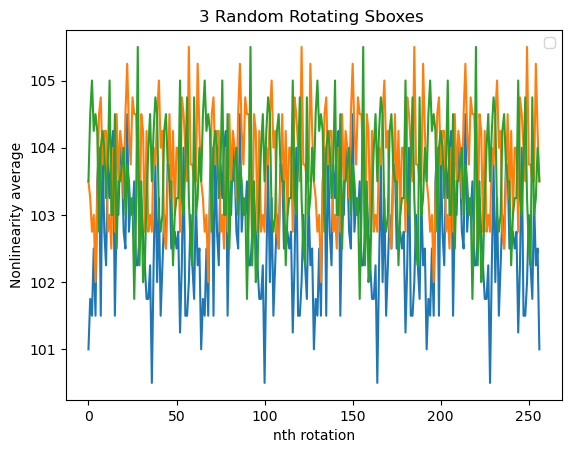

In [31]:
# sbtest = Sbox(sb_ediesca)
for j in range(len(sboxes)):   
    nl = np.average(sboxes[j].nonlinearity_analysis())
    # print(nl)
    nonlins = np.array(nl)
    n = len(sb_ediesca)

    for i in range(n):
        sboxes[j].rotation()
        nl = np.average(sboxes[j].nonlinearity_analysis())
        # print(nl)
        nonlins=np.append(nonlins,nl)
        # np.stack((nonlins,nl))


    plt.plot(nonlins)
# plt.hlines(np.max(avg),0,257,label=np.max(avg),colors='r')
# plt.hlines(np.min(avg),0,257,label=np.min(avg))
# print(np.min(avg))
plt.ylabel('Nonlinearity average')
plt.xlabel('nth rotation')
plt.legend()
plt.title('3 Random Rotating Sboxes ')
plt.show()


# SAC rotating average

0.4968265625


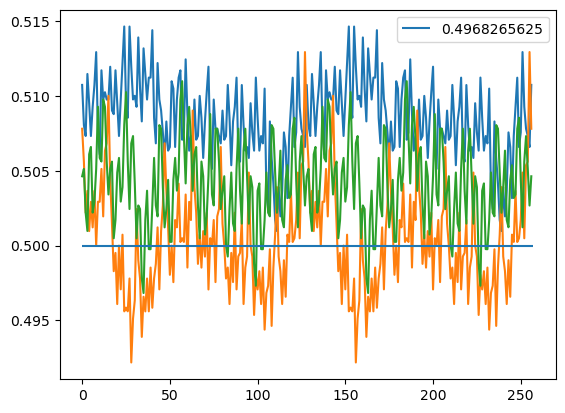

In [ ]:
for j in range(len(sboxes)):   
    sac_res = np.average(sboxes[j].sac_analysis())
    # print(nl)
    sacreslts = np.array(sac_res)
    n = len(sb_ediesca)

    for i in range(n):
        sboxes[j].rotation()
        sac_res = np.average(sboxes[j].sac_analysis())
        # print(nl)
        sacreslts=np.append(sacreslts,sac_res)
        # np.stack((nonlins,nl))

    plt.plot(sacreslts)

plt.legend()
# plt.hlines(np.max(sacreslts),0,257,label=np.max(sacreslts),colors='r')
# plt.hlines(np.min(sacreslts),0,257,label=np.min(sacreslts))
plt.hlines(0.5,0,257,label=np.min(sacreslts))
print(np.min(sacreslts))

plt.show()

In [17]:
linP_res = sboxes[0].linear_probability()
# print(nl)
linPreslts = np.array(linP_res)
n = len(sboxes[0].table)
for i in range(n):
    sboxes[0].rotation()
    linP_res = sboxes[0].linear_probability()
    # print(nl)
    linPreslts=np.append(linPreslts,linP_res)
    # np.stack((nonlins,nl))


plt.plot(linPreslts)
plt.hlines(np.max(linPreslts),0,257,label=np.max(linPreslts),colors='r')
plt.hlines(np.min(linPreslts),0,257,label=np.min(linPreslts))
print(np.min(linPreslts))
plt.legend()
plt.show()

KeyboardInterrupt: 

0.0390625


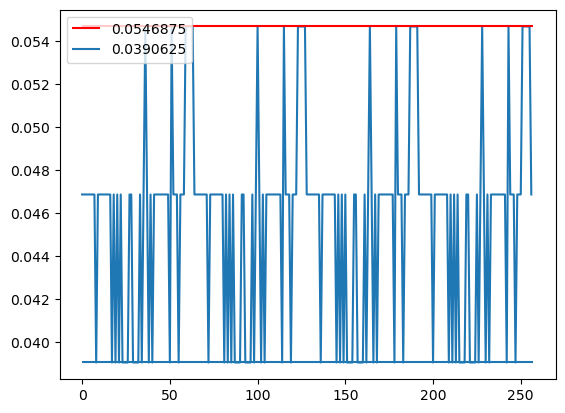

In [14]:
diffP_res = sboxes[0].differential_probability()
# print(nl)
diffPreslts = np.array(diffP_res)
n = len(sboxes[0].table)
for i in range(n):
    sboxes[0].rotation()
    diffP_res = sboxes[0].differential_probability()
    # print(nl)
    diffPreslts=np.append(diffPreslts,diffP_res)
    # np.stack((nonlins,nl))


plt.plot(diffPreslts)
plt.hlines(np.max(diffPreslts),0,257,label=np.max(diffPreslts),colors='r')
plt.hlines(np.min(diffPreslts),0,257,label=np.min(diffPreslts))
print(np.min(diffPreslts))
plt.legend()
plt.show()

In [16]:
bicnlres = sboxes[0].bic_average(sboxes[0].bicnonl_analysis())[0]
bicnlrslts = np.array(bicnlres)
n = len(sboxes[0].table)
for i in range(n):
    sboxes[0].rotation()
    bicnlres = sboxes[0].bic_average(sboxes[0].bicnonl_analysis())[0]
    # print(nl)
    bicnlrslts=np.append(bicnlrslts,bicnlres)

plt.plot(bicnlrslts)
plt.hlines(np.max(bicnlrslts),0,257,label=np.max(bicnlrslts),colors='r')
plt.hlines(np.min(bicnlrslts),0,257,label=np.min(bicnlrslts))
print(np.min(bicnlrslts))
plt.legend()
plt.show()

KeyboardInterrupt: 

In [18]:
bicSACres = sboxes[0].bic_average(sboxes[0].bicsac_analysis())[0]
bicSACrslts = np.array(bicSACres)
n = len(sboxes[0].table)
for i in range(n):
    sboxes[0].rotation()
    bicSACres = sboxes[0].bic_average(sboxes[0].bicnonl_analysis())[0]
    # print(nl)
    bicSACrslts=np.append(bicSACrslts,bicSACres)

plt.plot(bicSACrslts)
plt.hlines(np.max(bicSACrslts),0,257,label=np.max(bicSACrslts),colors='r')
plt.hlines(np.min(bicSACrslts),0,257,label=np.min(bicSACrslts))
print(np.min(bicSACrslts))
plt.legend()
plt.show()

KeyboardInterrupt: 

# Last sbox main rotor

## Codification sequence, figure shows results of cipher in each stage 
## (after each sbox codification)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/3034984310.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


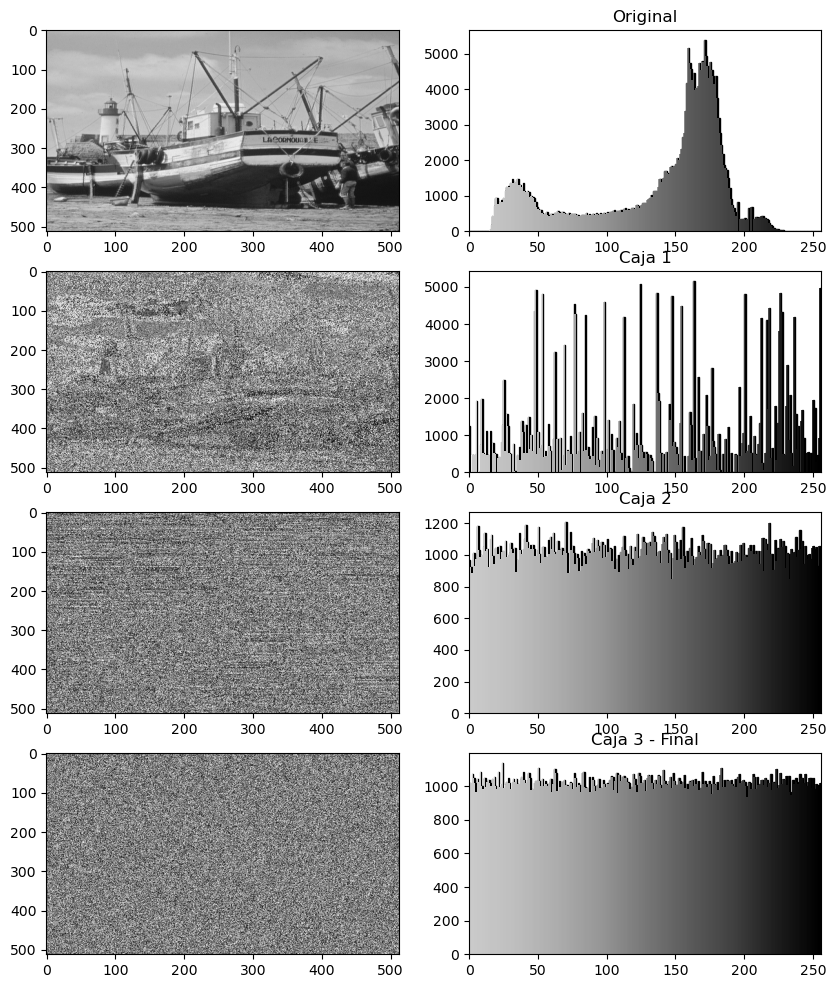

In [23]:
def stepped_enigmarot_cipher(image,xinits,params):
    k=3
    img_array = np.array(image)
    n,m = img_array.shape[0],img_array.shape[1]
    sboxes = [Sbox(ciphers.generate_sbox(xinits[i][0],xinits[i][1],f1=params[0],f2=params[1])) for i in range(k)]
    # print(sboxes[0].table)
    # print(sboxes[1].table)
    # print(sboxes[2].table)
    
    cipher_arr = np.zeros((n,m))
    aux1_arr = np.zeros((n,m))
    aux2_arr = np.zeros((n,m))
    for c in range(n):
        for r in range(m):
            aux = sboxes[0].table[int(img_array[c,r])]
            aux1_arr[c,r] = aux
            aux = sboxes[1].table[int(aux)]
            aux2_arr[c,r] = aux
            aux = sboxes[2].table[int(aux)]
            cipher_arr[c,r] = aux
            sboxes[k-1].rotation()
            # rot_cont[k-1]=sboxes[k-1].rot_cont
            if sboxes[k-1].rot_cont%256==0 and sboxes[k-1].rot_cont!=0:      
                sboxes[k-2].rotation()
                # rot_cont[k-2]+=1
                # print("Rot 2:")
                # print("table:"+str(sboxes[k-2].table))
                # print("rots:"+str(sboxes[k-2].rot_cont))
            
            if sboxes[k-2].rot_cont%256==0 and sboxes[k-2].rot_cont!=0:
                sboxes[k-3].rotation()
                # rot_cont[k-3]=sboxes[k-3].rot_cont
                sboxes[k-2].rot_cont=0 #?????
                # print("Rot 3:")
                # print("table:"+str(sboxes[k-3].table))
                # print("rots:"+str(sboxes[k-3].rot_cont))
                

            if sboxes[k-3].rot_cont%256==0 and sboxes[k-3].rot_cont!=0:
                print("ya es toda we ",sboxes[k-3].rot_cont)

    sboxes[0].reset_table()
    sboxes[1].reset_table()
    sboxes[2].reset_table()
    # print(sboxes[0].table)
    # print(sboxes[1].table)
    # print(sboxes[2].table)
    # rot_cont = [sboxes[0].rot_cont,sboxes[1].rot_cont,sboxes[2].rot_cont]
    
    return cipher_arr,aux1_arr,aux2_arr

boats_cipher_arr,boats_encode1,boats_encode2 = stepped_enigmarot_cipher(boats_arr,xinits,params)
boats_ciph = Image.fromarray(boats_cipher_arr)
boats_subciph1 = Image.fromarray(boats_encode1)
boats_subciph2 = Image.fromarray(boats_encode2)

boats_arrs = [boats_cipher_arr,boats_encode1,boats_encode2]
boats_images = [boats_img,boats_subciph1,boats_subciph2,boats_ciph]

fig, axs = plt.subplots(len(boats_images), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')
titles = ["Original","Caja 1","Caja 2", "Caja 3 - Final"]

for i,img in enumerate(boats_images):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray',aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()


# First sbox main rotor

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/3996883811.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


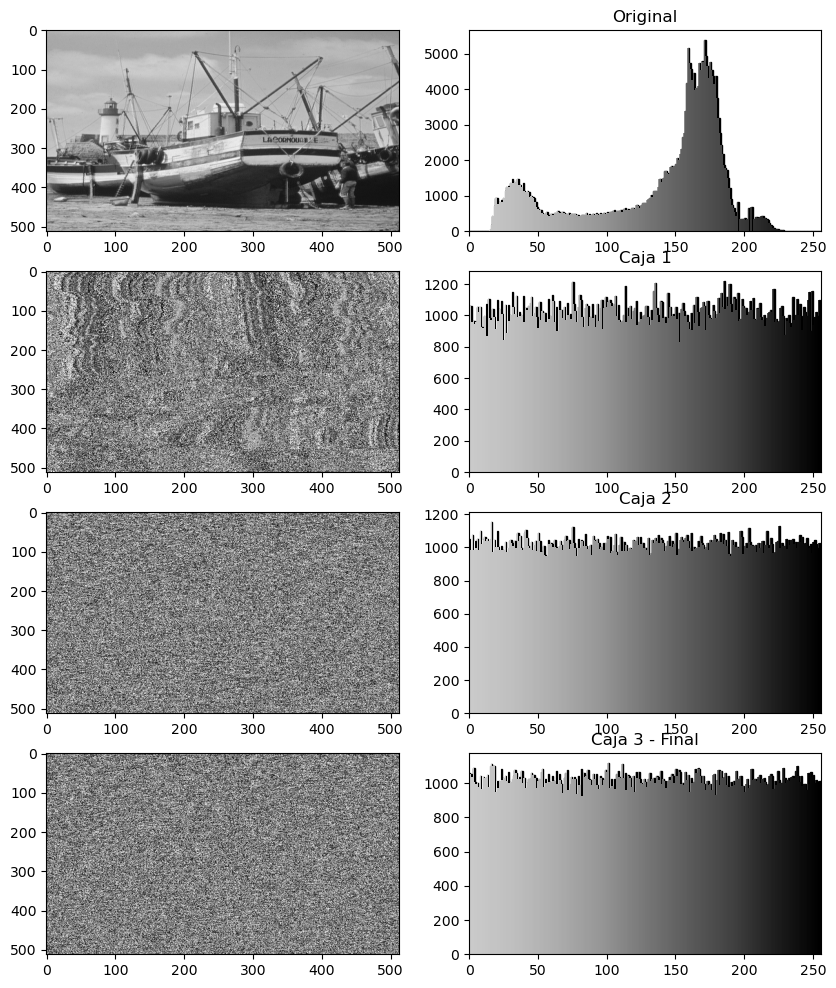

In [24]:
def stepped_enigmarot_cipher(image,xinits,params):
    k=3
    img_array = np.array(image)
    n,m = img_array.shape[0],img_array.shape[1]
    sboxes = [Sbox(ciphers.generate_sbox(xinits[i][0],xinits[i][1],f1=params[0],f2=params[1])) for i in range(k)]
    # print(sboxes[0].table)
    # print(sboxes[1].table)
    # print(sboxes[2].table)
    
    cipher_arr = np.zeros((n,m))
    aux1_arr = np.zeros((n,m))
    aux2_arr = np.zeros((n,m))
    for c in range(n):
        for r in range(m):
            aux = sboxes[0].table[int(img_array[c,r])]
            aux1_arr[c,r] = aux
            aux = sboxes[1].table[int(aux)]
            aux2_arr[c,r] = aux
            aux = sboxes[2].table[int(aux)]
            cipher_arr[c,r] = aux
            sboxes[k-k].rotation()
            # rot_cont[k-1]=sboxes[k-1].rot_cont
            if sboxes[k-k].rot_cont%256==0 and sboxes[k-k].rot_cont!=0:      
                sboxes[k-2].rotation()
                # rot_cont[k-2]+=1
                # print("Rot 2:")
                # print("table:"+str(sboxes[k-2].table))
                # print("rots:"+str(sboxes[k-2].rot_cont))
            
            if sboxes[k-2].rot_cont%256==0 and sboxes[k-2].rot_cont!=0:
                sboxes[k-1].rotation()
                # rot_cont[k-3]=sboxes[k-3].rot_cont
                sboxes[k-2].rot_cont=0 #?????
                # print("Rot 3:")
                # print("table:"+str(sboxes[k-3].table))
                # print("rots:"+str(sboxes[k-3].rot_cont))
                

            if sboxes[k-1].rot_cont%256==0 and sboxes[k-1].rot_cont!=0:
                print("ya es toda we ",sboxes[k-1].rot_cont)

    sboxes[0].reset_table()
    sboxes[1].reset_table()
    sboxes[2].reset_table()
    # print(sboxes[0].table)
    # print(sboxes[1].table)
    # print(sboxes[2].table)
    # rot_cont = [sboxes[0].rot_cont,sboxes[1].rot_cont,sboxes[2].rot_cont]
    
    return cipher_arr,aux1_arr,aux2_arr

boats_cipher_arr,boats_encode1,boats_encode2 = stepped_enigmarot_cipher(boats_arr,xinits,params)
boats_ciph = Image.fromarray(boats_cipher_arr)
boats_subciph1 = Image.fromarray(boats_encode1)
boats_subciph2 = Image.fromarray(boats_encode2)

boats_arrs = [boats_cipher_arr,boats_encode1,boats_encode2]
boats_images = [boats_img,boats_subciph1,boats_subciph2,boats_ciph]

fig, axs = plt.subplots(len(boats_images), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')

for i,img in enumerate(boats_images):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()


# White image double cipher with steps

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/510391288.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


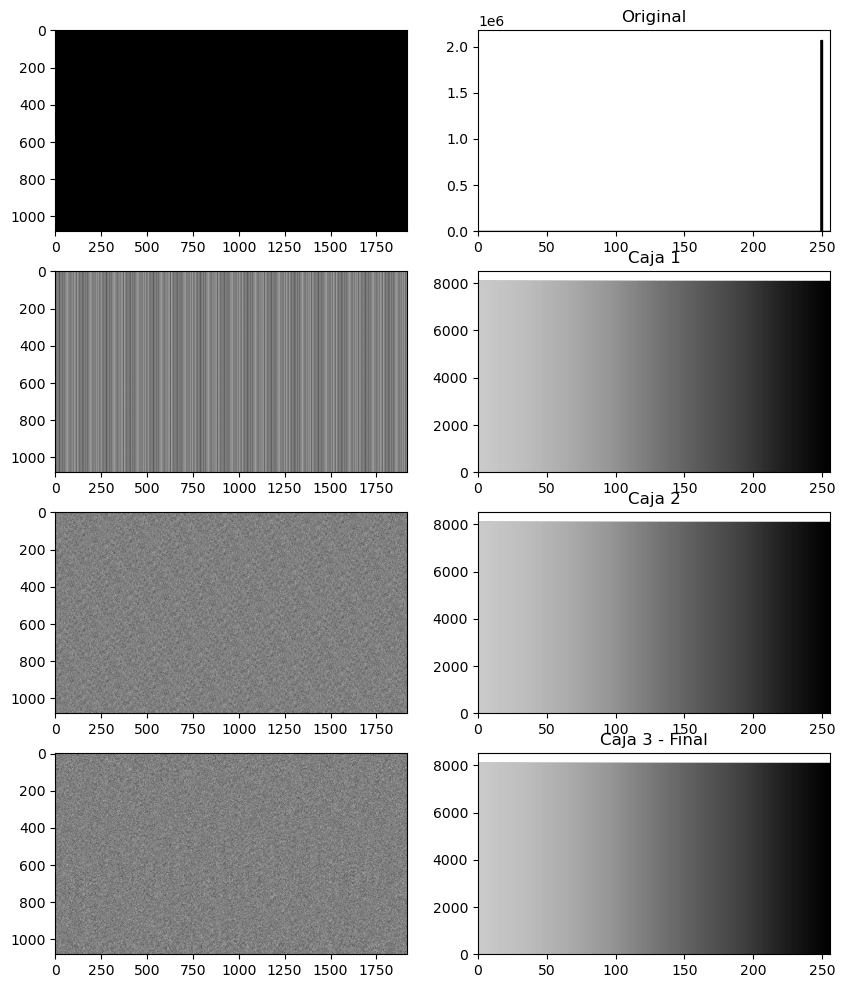

In [25]:
# whitearr = np.zeros([512,512,3],dtype=np.int16)
# whitearr.fill(255)
# whitreimg = Image.fromarray(whitearr)
white_cipher_arr,white_encode1,white_encode2 = stepped_enigmarot_cipher(white_arr,xinits,params)
white_ciph = Image.fromarray(white_cipher_arr)
white_subciph1 = Image.fromarray(white_encode1)
white_subciph2 = Image.fromarray(white_encode2)

# white_arrs = [white_cipher_arr,white_encode1,white_encode2]
white_images = [white_img,white_subciph1,white_subciph2,white_ciph]

fig, axs = plt.subplots(len(boats_images), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')

for i,img in enumerate(white_images):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/2374950672.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


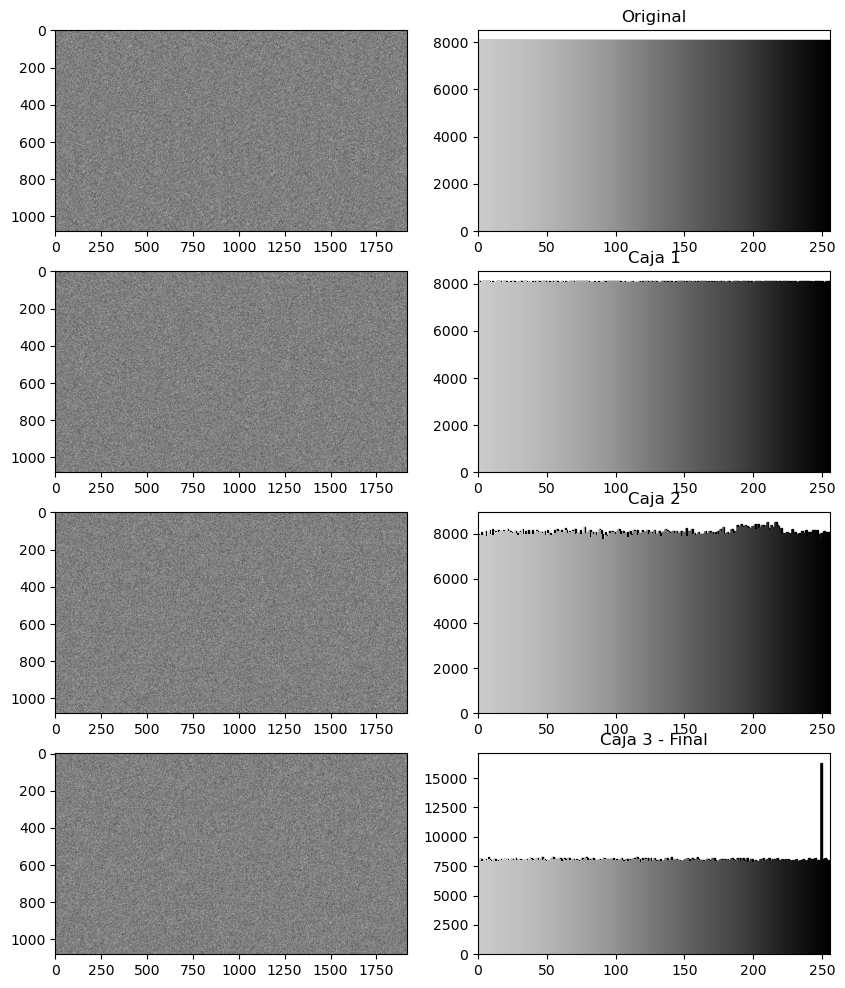

In [26]:
# whitearr = np.zeros([512,512,3],dtype=np.int16)
# whitearr.fill(255)
# whitreimg = Image.fromarray(whitearr)
white_cipher_arr2,white_2encode1,white_2encode2 = stepped_enigmarot_cipher(white_cipher_arr,xinits,params)
white_ciph2 = Image.fromarray(white_cipher_arr2)
white_2subciph1 = Image.fromarray(white_2encode1)
white_2subciph2 = Image.fromarray(white_2encode2)

# white_arrs = [white_cipher_arr,white_encode1,white_encode2]
white_images2 = [white_ciph,white_2subciph1,white_2subciph2,white_ciph2]

fig, axs = plt.subplots(len(boats_images), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')

for i,img in enumerate(white_images2):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()


# Tones image double cipher showing steps

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/1011429503.py:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


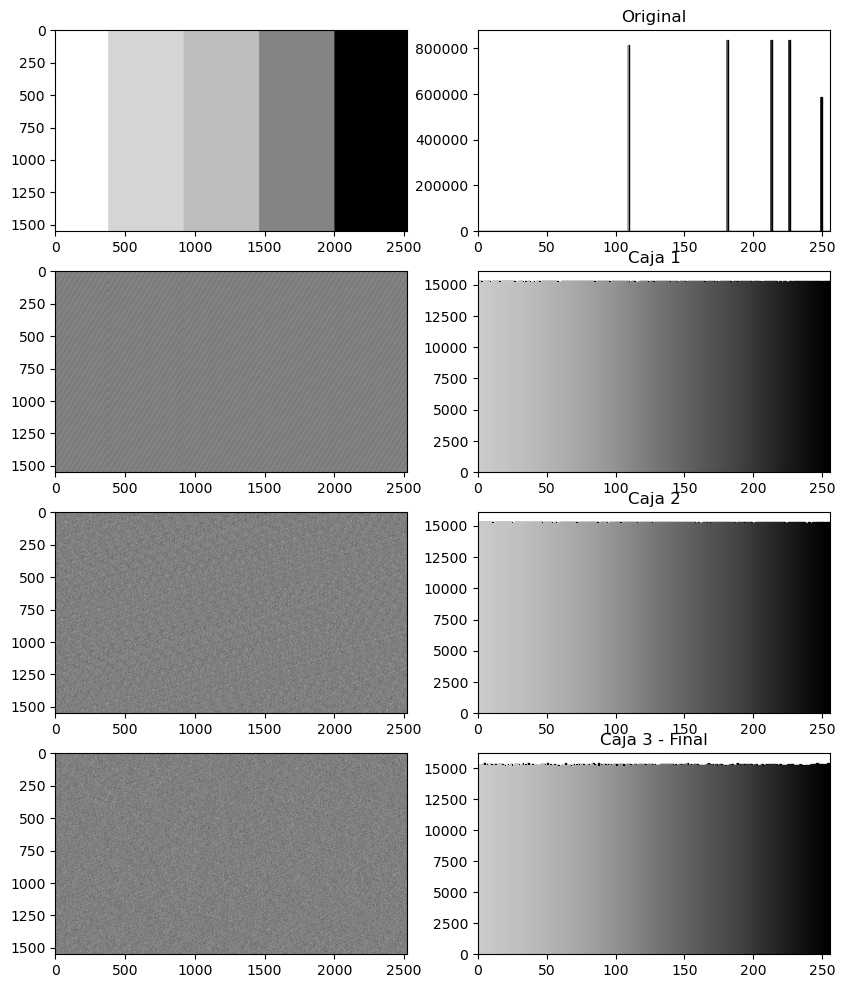

In [27]:
tones_cipher_arr,tones_encode1,tones_encode2 = stepped_enigmarot_cipher(tones_arr,xinits,params)
tones_ciph = Image.fromarray(tones_cipher_arr)
tones_subciph1 = Image.fromarray(tones_encode1)
tones_subciph2 = Image.fromarray(tones_encode2)

# white_arrs = [white_cipher_arr,white_encode1,white_encode2]
tones_images = [tones_img,tones_subciph1,tones_subciph2,tones_ciph]

fig, axs = plt.subplots(len(tones_images), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')

for i,img in enumerate(tones_images):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()


/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96159/3876348738.py:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


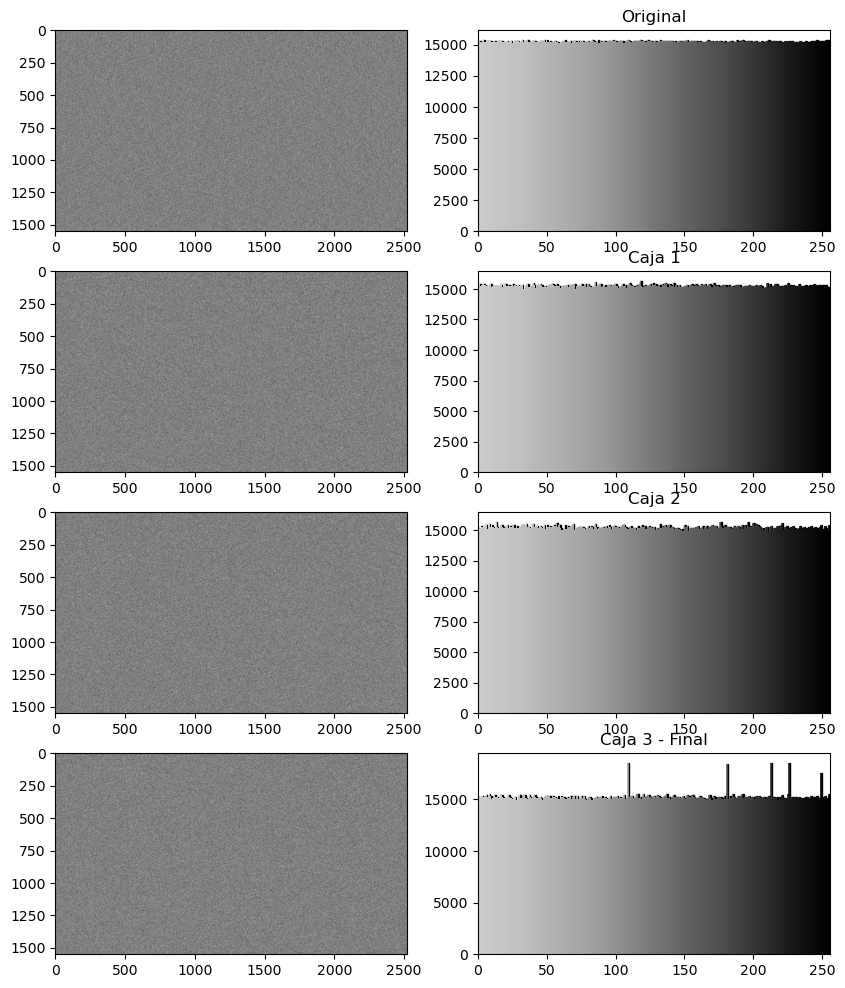

In [28]:
tones_cipher_arr2,tones_2encode1,tones_2encode2 = stepped_enigmarot_cipher(tones_cipher_arr,xinits,params)
tones_ciph2 = Image.fromarray(tones_cipher_arr2)
tones_2subciph1 = Image.fromarray(tones_2encode1)
tones_2subciph2 = Image.fromarray(tones_2encode2)

# white_arrs = [white_cipher_arr,white_encode1,white_encode2]
tones_images2 = [tones_ciph,tones_2subciph1,tones_2subciph2,tones_ciph2]

fig, axs = plt.subplots(len(tones_images2), 2,figsize=(10,12))
cm = plt.cm.get_cmap('Greys')

for i,img in enumerate(tones_images2):
        # print(img)
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        # print(histogram)
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)
        axs[i,1].set_title(titles[i])
        
plt.show()


/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96071/3692587557.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
0.5011129379272461
End, rotcont:
262144 0 4
Time:
0.5265443325042725
End, rotcont:
262144 0 4
Time:
0.5006039142608643
End, rotcont:
262144 0 4
Time:
0.49867892265319824
End, rotcont:
262144 0 4
Time:
0.500952959060669
End, rotcont:
262144 0 4


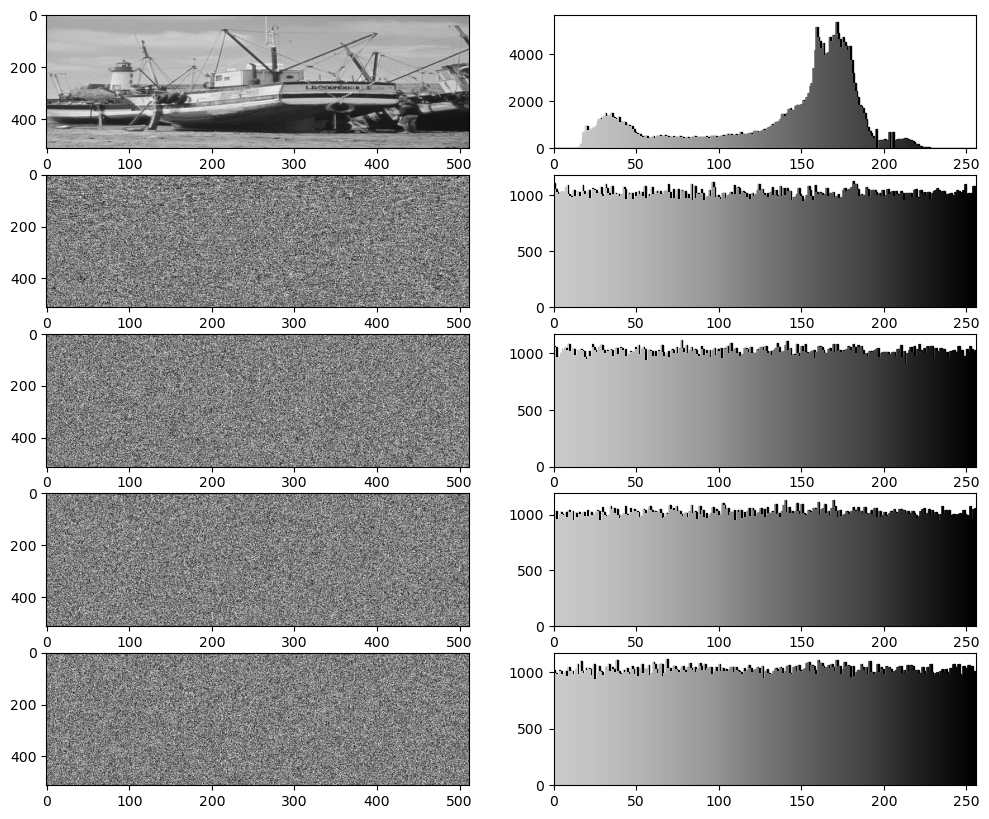

In [7]:
def cipher_sequence(image,xinits,params,n,dim):
    fig, axs = plt.subplots(n, 2,figsize=dim)
    cm = plt.cm.get_cmap('Greys')
    img = image
    for i in range(n):
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)

        last = img
        ciph = ciphers.enigmarot_cipher(img,xinits,params) 
        img = Image.fromarray(ciph[0])

    return last

def decipher_sequence(image,xinits,params,n,dim):
    fig, axs = plt.subplots(n, 2,figsize=dim)
    cm = plt.cm.get_cmap('Greys')
    img = image
    for i in range(n):
        histogram, bins = np.histogram(img, bins=256, range=(0, 256))
        axs[i,0].imshow(img, cmap='gray', aspect='auto')

        axs[i,1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
        x_span = bins.max()-bins.min()
        C = [cm(((x-bins.min())/x_span)) for x in bins]
        axs[i,1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
        axs[i,1].set_xlim(0,256)

        last = img
        ciph = ciphers.enigmarot_decipher(img,xinits,params) 
        img = Image.fromarray(ciph[0])
    
    return last

boat_seqcipher = cipher_sequence(boats_arr,xinits,params,5,(12,10))

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96071/3692587557.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
0.13663697242736816
End, rotcont:
65536 0 1
Time:
0.1380012035369873
End, rotcont:
65536 0 1
Time:
0.1403651237487793
End, rotcont:
65536 0 1
Time:
0.15012884140014648
End, rotcont:
65536 0 1
Time:
0.1429309844970703
End, rotcont:
65536 0 1


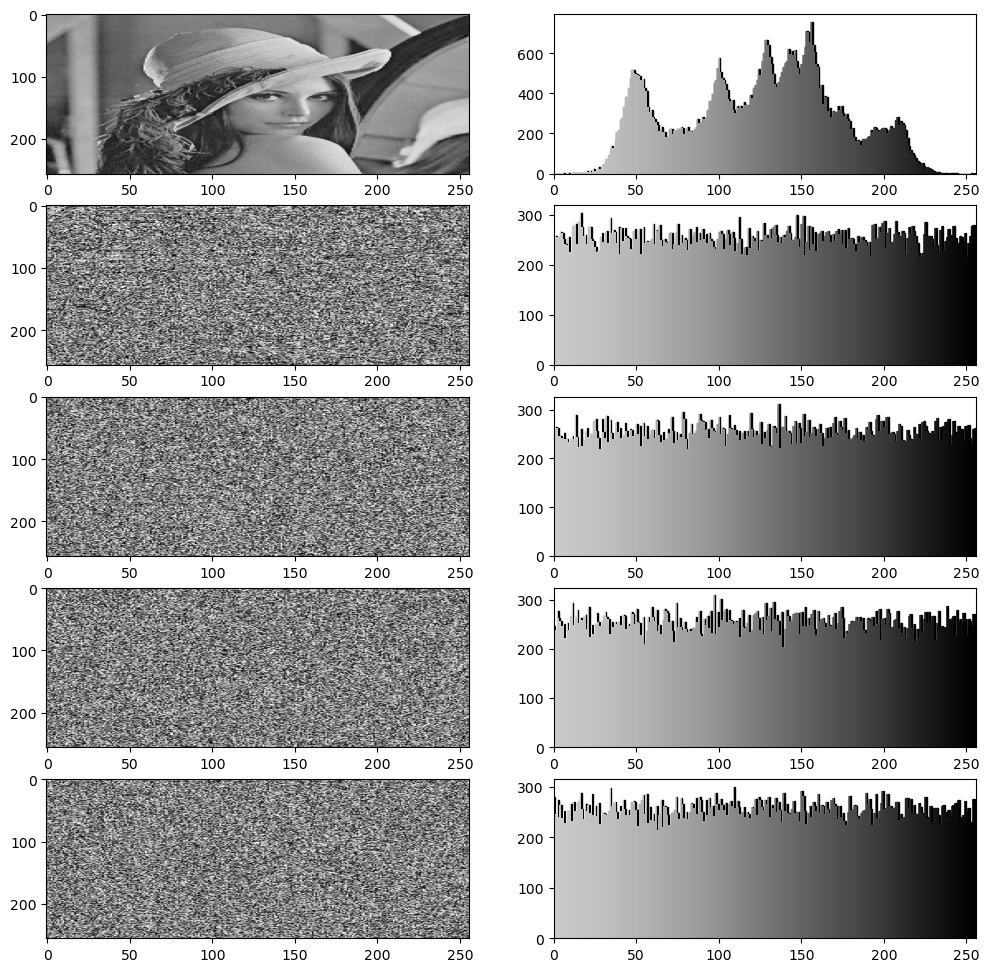

In [8]:
lena_seqcipher = cipher_sequence(lena_arr,xinits,params,5,(12,12))

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96071/3692587557.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
12.11988878250122
Time:
11.922542810440063
Time:
11.727928876876831
Time:
11.835741758346558
Time:
11.843381881713867


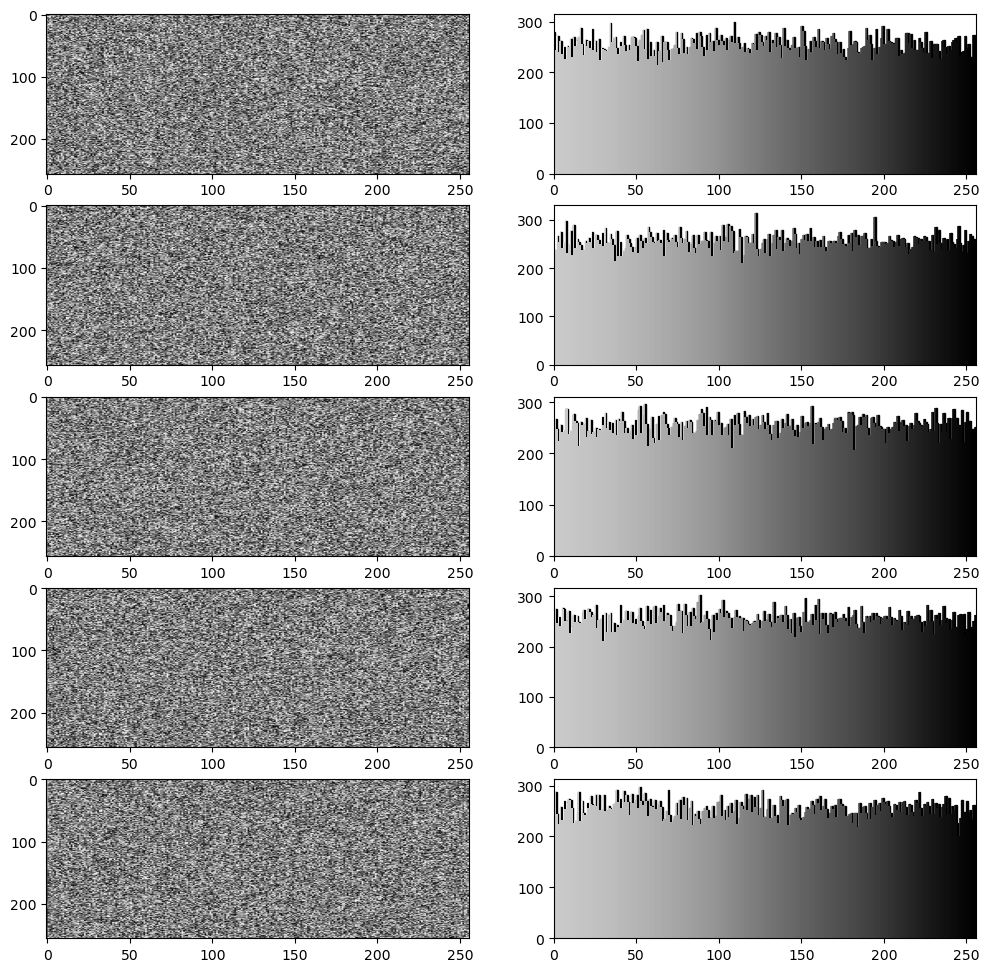

In [12]:
lena_seqdecipher = decipher_sequence(lena_seqcipher,xinits,params,5,(12,12))

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_96071/3692587557.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
5.12362003326416
End, rotcont:
2073600 164 31
Time:
4.225963830947876
End, rotcont:
2073600 164 31
Time:
4.141443967819214
End, rotcont:
2073600 164 31
Time:
3.966742992401123
End, rotcont:
2073600 164 31
Time:
4.22898006439209
End, rotcont:
2073600 164 31


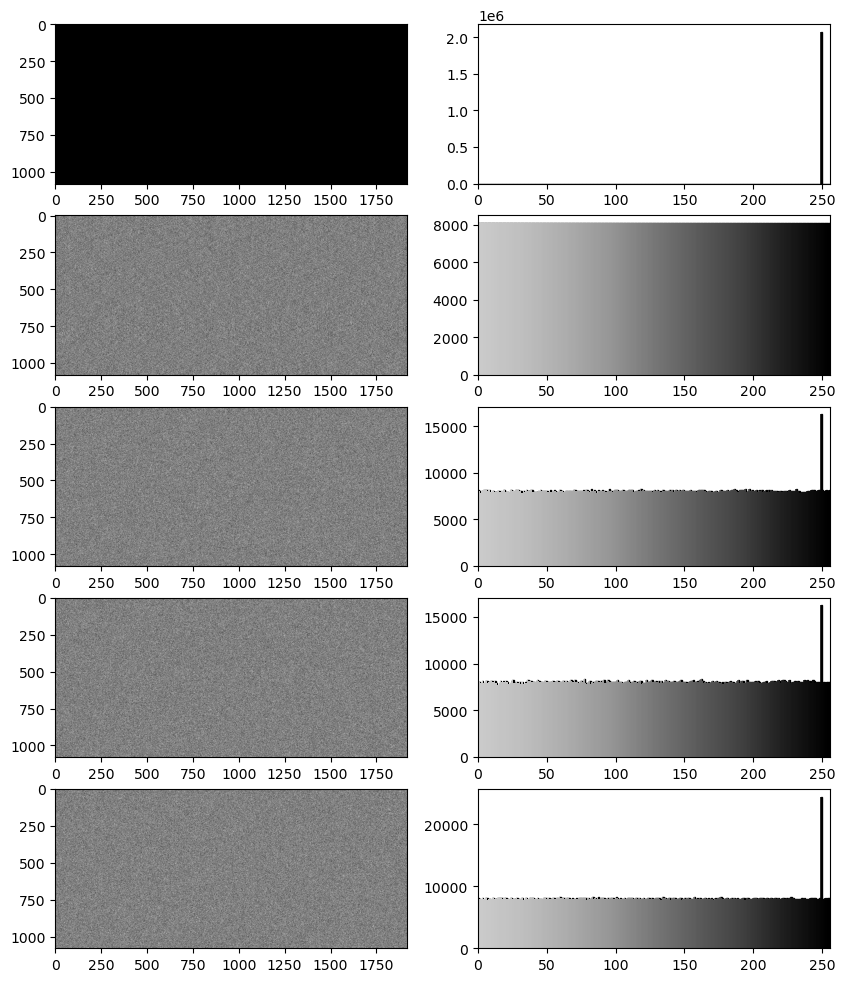

In [11]:
white_seqcipher = cipher_sequence(white_arr,xinits,params,5,(10,12))

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_23100/3692587557.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
7.547943830490112
End, rotcont:
59 178 3912200
Time:
7.514163255691528
End, rotcont:
59 178 3912200
Time:
7.337949275970459
End, rotcont:
59 178 3912200
Time:
7.554170846939087
End, rotcont:
59 178 3912200
Time:
7.618929862976074
End, rotcont:
59 178 3912200
Time:
7.654938220977783
End, rotcont:
59 178 3912200
Time:
7.844677925109863
End, rotcont:
59 178 3912200


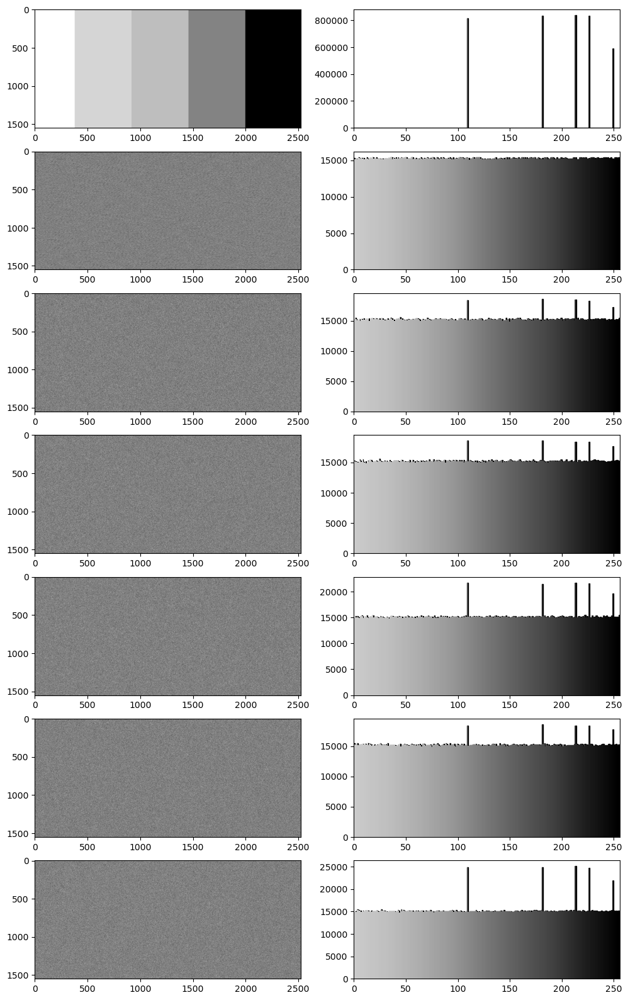

In [55]:
tones_seqcipher = cipher_sequence(tones_img,xinits,params,7,(12,20))

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_23100/3692587557.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


Time:
4.370294094085693
End, rotcont:
34 85 2250000
Time:
4.455244064331055
End, rotcont:
34 85 2250000
Time:
4.605889081954956
End, rotcont:
34 85 2250000
Time:
4.5279316902160645
End, rotcont:
34 85 2250000
Time:
4.517306327819824
End, rotcont:
34 85 2250000


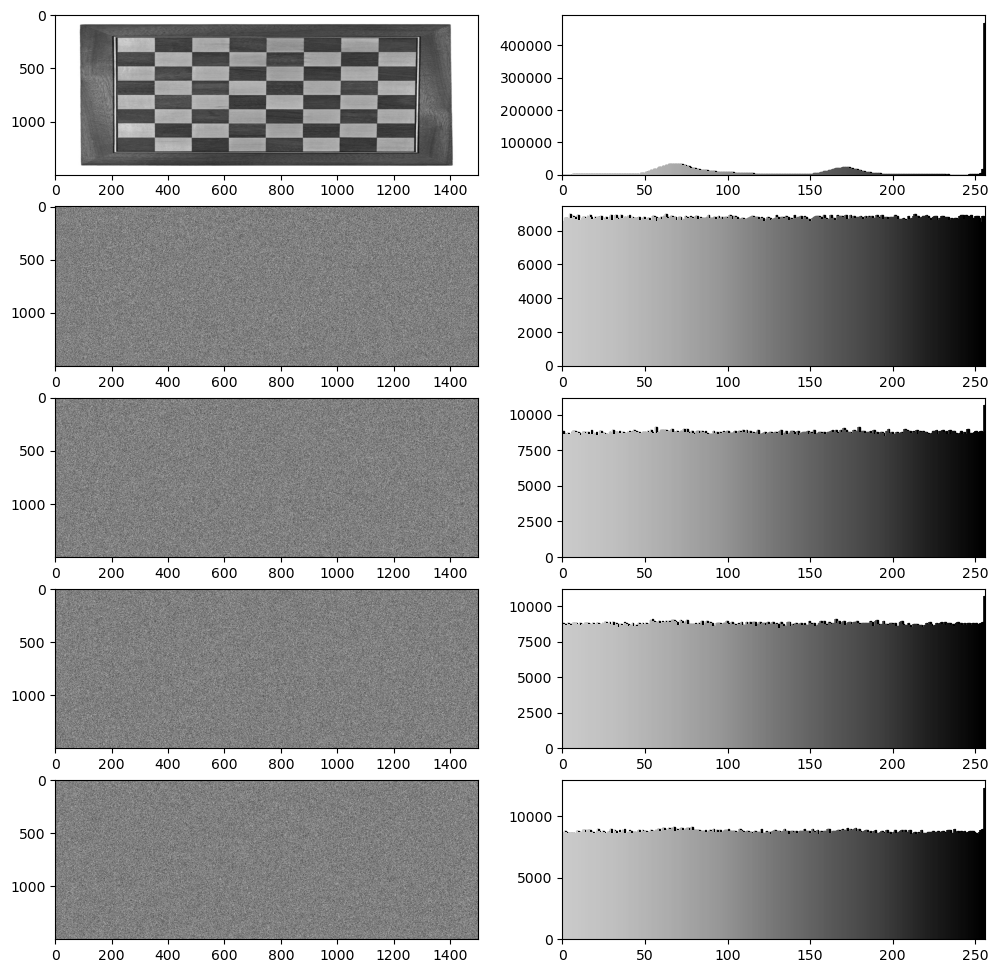

In [56]:
chess_seqcipher = cipher_sequence(chess_img,xinits,params,5,(12,12))

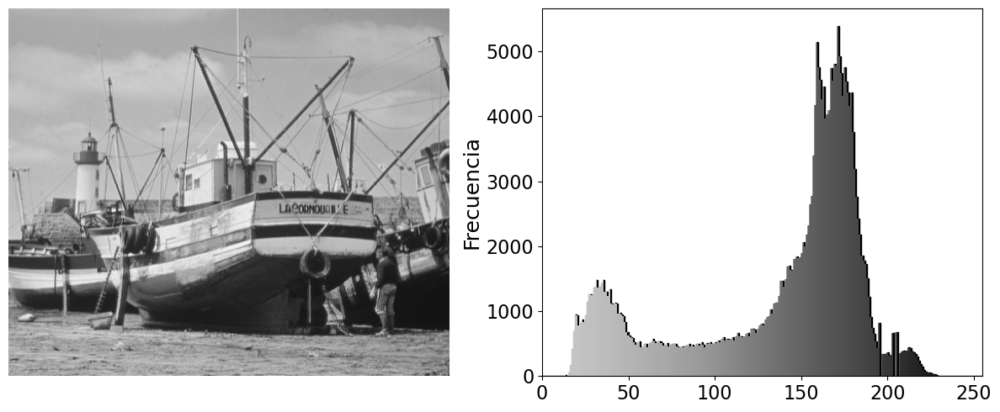

262144


In [35]:
bins, hist = ciphers.plot_image_and_histogram(boats_img)
print(np.sum(hist))

In [11]:
# generates random numbers within decimal intervals and desired precision
# m1_params = np.random.random_integers(8000,10000,2)/10000
# m2_params = np.random.random_integers(2000,10000,2)/1000
# b1_params = np.random.random_integers(8000,50000,2)/1000
m1_params = np.random.uniform(0.7,1,2)
m2_params = np.random.uniform(2,10,2)
b1_params = np.random.uniform(8,45,2)
params = [[m1_params[0],m2_params[0],b1_params[0]],[m1_params[1],m2_params[1],b1_params[1]]]
print(params[0],params[1])
b2_invariant = b1_params*(m2_params/m1_params)
print(b2_invariant)
xinits = [[np.random.uniform(-np.floor(b2_invariant[0]),np.floor(b2_invariant[0])),np.random.uniform(-np.floor(b2_invariant[1]),np.floor(b2_invariant[1]))] for i in range(3)]
print(xinits)
boats_cipher_arr,boats_xinits,boats_rot_cont,boats_sboxes = ciphers.enigmarot_cipher(boats_img,xinits,params) 

[0.9640428744240037, 7.839715495354756, 41.34441377551182] [0.9891856538472142, 5.742506180956558, 24.810565791870978]
[336.21786948 144.03244412]
[[185.72162871013933, -57.743936015348986], [-175.3090033172533, -43.570543543179745], [-21.859434585474418, 111.01152816131278]]
Time:
0.9132239818572998
End, rotcont:
4 0 262144


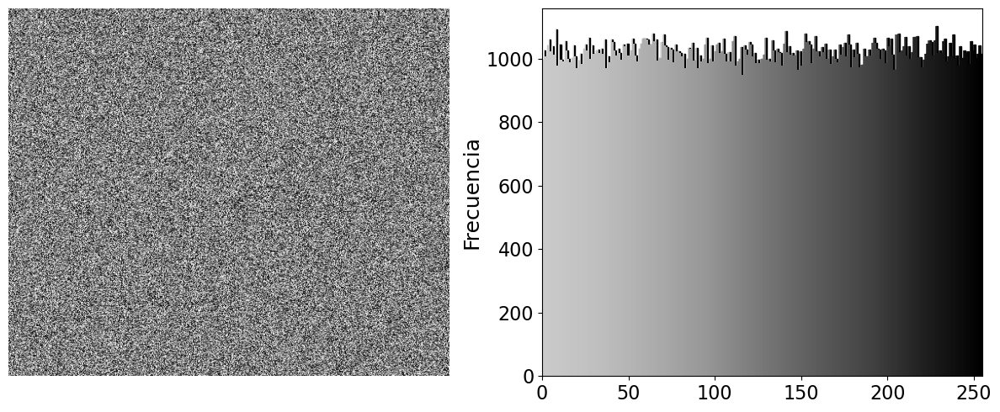

262144


In [12]:
boats_ciph = Image.fromarray(boats_cipher_arr)
boats_ciphHist=ciphers.plot_image_and_histogram(boats_ciph)
print(np.sum(boats_ciphHist[1]))

Time:
0.5124330520629883
End, rotcont:
4 0 262144


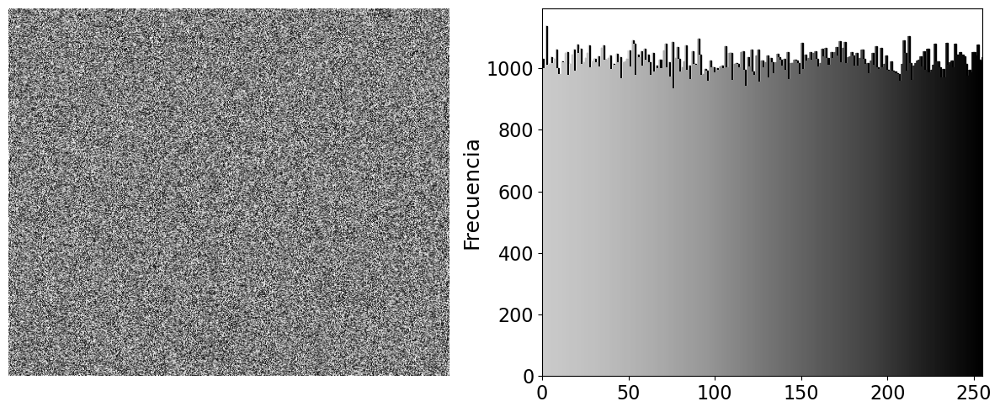

In [39]:
boats_cipher_arr2,boats_xinits2,boats_rot_cont2,boats_sboxes2 = ciphers.enigmarot_cipher(boats_ciph,xinits,params) 
boats_ciph2 = ciphers.plot_image_and_histogram(boats_cipher_arr2)

Time:
0.5076439380645752
End, rotcont:
4 0 262144


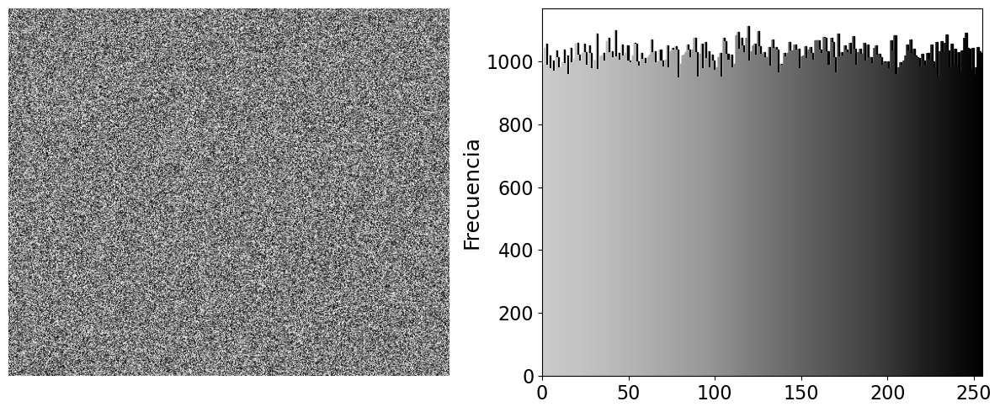

In [41]:
boats_cipher2 = Image.fromarray(boats_cipher_arr2)
boats_cipher_arr3,boats_xinits3,boats_rot_cont3,boats_sboxes3 = ciphers.enigmarot_cipher(boats_cipher2,xinits,params) 
boats_ciph3 = ciphers.plot_image_and_histogram(boats_cipher_arr3)

In [10]:
boats_undo = ciphers.enigmarot_decipher(boats_ciph,boats_xinits,params)

Time:
52.22969079017639


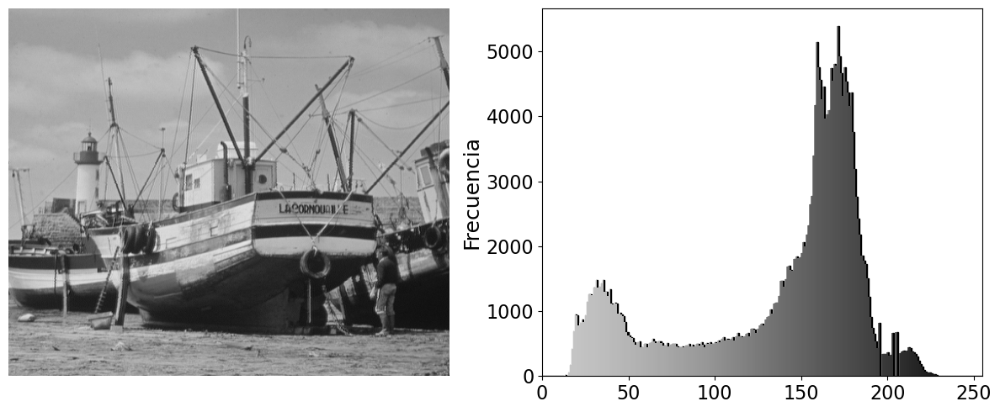

262144


In [11]:
boats_deciph = Image.fromarray(boats_undo[0])
boats_deciphHist=ciphers.plot_image_and_histogram(boats_deciph)
print(np.sum(boats_deciphHist[1]))

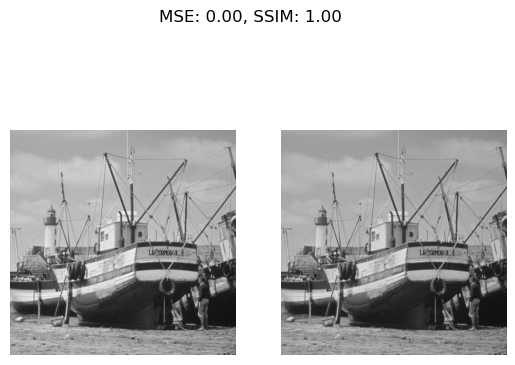

In [62]:
from skimage.metrics import structural_similarity as ssim

def mse(imageA, imageB):
	# the 'Mean Squared Error' between the two images is the
	# sum of the squared difference between the two images;
	# NOTE: the two images must have the same dimension
	err = np.sum((imageA - imageB) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1])
	
	# return the MSE, the lower the error, the more "similar"
	# the two images are
	return err

def compare_images(imageA, imageB):
	# compute the mean squared error and Structural similarity index
	# index for the images
	imA=np.array(imageA)
	imB=np.array(imageB)
	m = ciphers.mse(imA, imB)
	s = ssim(imA, imB,data_range=np.max(imageA) - np.min(imageA))
	# setup the figure
	fig = plt.figure()
	plt.suptitle("MSE: %.2f, SSIM: %.2f" % (m, s))
	# show first image
	ax = fig.add_subplot(1, 2, 1)
	plt.imshow(imageA, cmap='gray')
	plt.axis("off")
	# show the second image
	ax = fig.add_subplot(1, 2, 2)
	plt.imshow(imageB, cmap='gray')
	plt.axis("off")
	# show the images
	plt.show()


compare_images(boats_img,boats_deciph)

## Chess
### Original

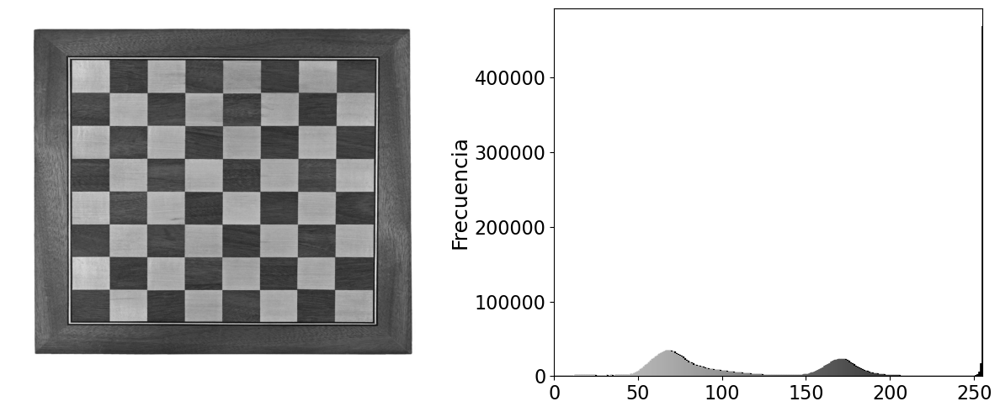

2250000


In [17]:
chessHist = ciphers.plot_image_and_histogram(chess_img)
print(np.sum(chessHist[1]))

In [18]:
chess_cipher_arr,chess_xinits,chess_rot_cont,chess_sboxes = ciphers.enigmarot_cipher(chess_img,xinits,params) 

Time:
4.190977096557617
End, rotcont:
34 85 2250000


### "Cifrado"

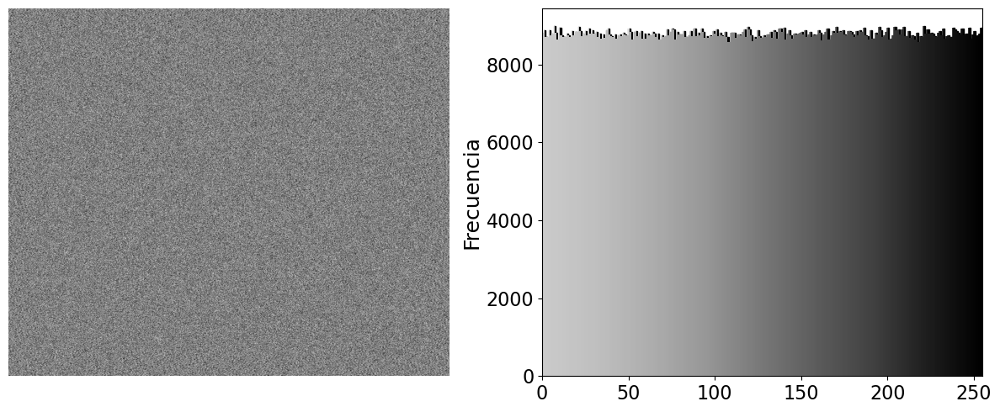

2250000


In [19]:
chess_ciph = Image.fromarray(chess_cipher_arr)
chess_ciphHist=ciphers.plot_image_and_histogram(chess_ciph)
print(np.sum(chess_ciphHist[1]))

In [20]:
chess_undo = ciphers.enigmarot_decipher(chess_ciph,chess_xinits,params)

Time:
407.97562193870544


### Decifrado

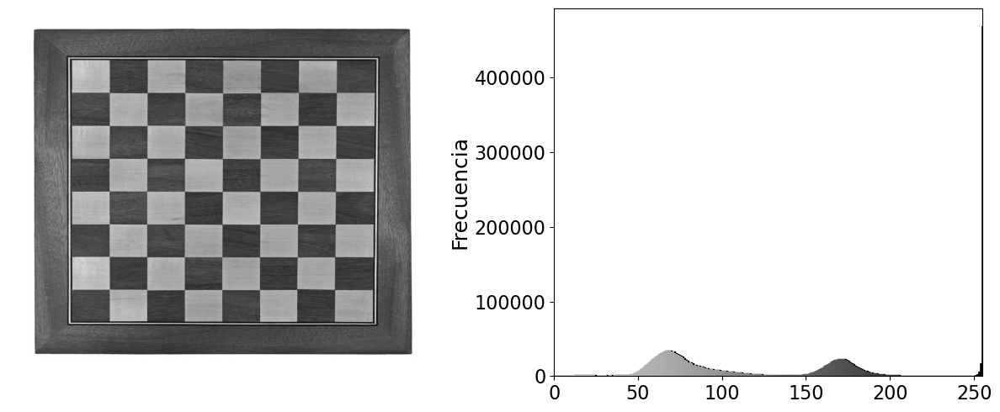

2250000


In [21]:
chess_deciph = Image.fromarray(chess_undo[0])
chess_deciphHist=ciphers.plot_image_and_histogram(chess_deciph)
print(np.sum(chess_deciphHist[1]))

### MSE e Indice de similitud estructural SSIM

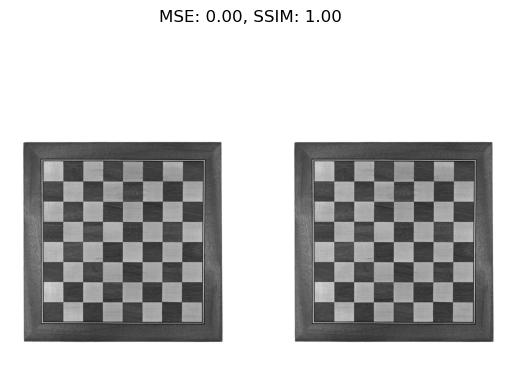

In [60]:
compare_images(chess_deciph,chess_img)

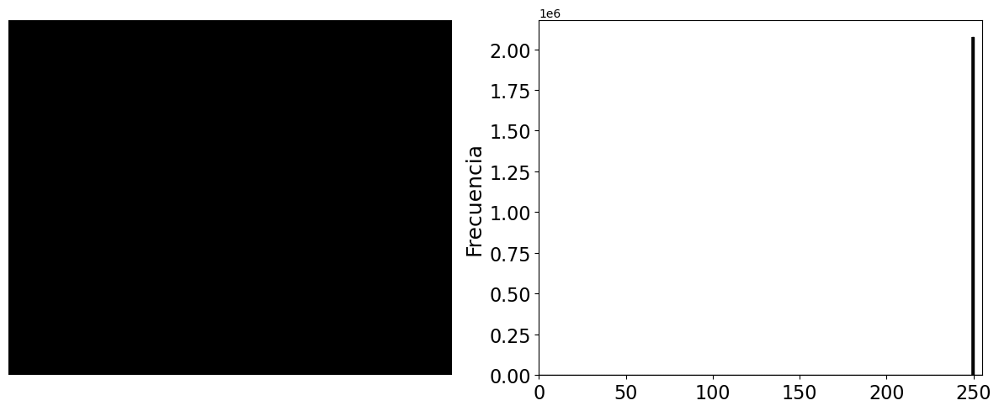

2073600


In [ ]:
blackHist=ciphers.plot_image_and_histogram(white_img)#1920X1080
print(np.sum(blackHist[1]))

In [69]:
black_cipher_arr,black_xinits,black_rot_cont,black_sboxes = ciphers.enigmarot_cipher(white_img,xinits,params) 

Time:
3.7074289321899414
End, rotcont:
31 164 2073600


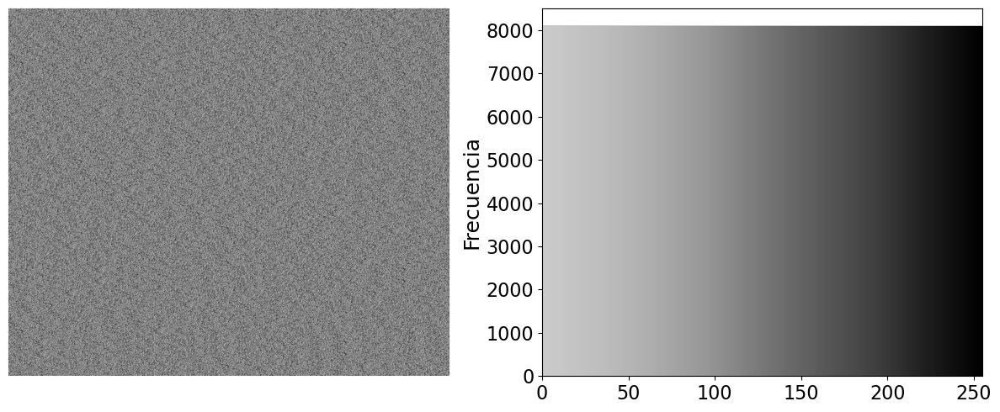

2073600


In [70]:
black_ciph = Image.fromarray(black_cipher_arr)
black_ciphHist=ciphers.plot_image_and_histogram(black_ciph)
print(np.sum(black_ciphHist[1]))

In [ ]:
doublecipher = 

In [72]:
white_undo = ciphers.enigmarot_decipher(black_ciph,black_xinits,params)

Time:
385.677166223526


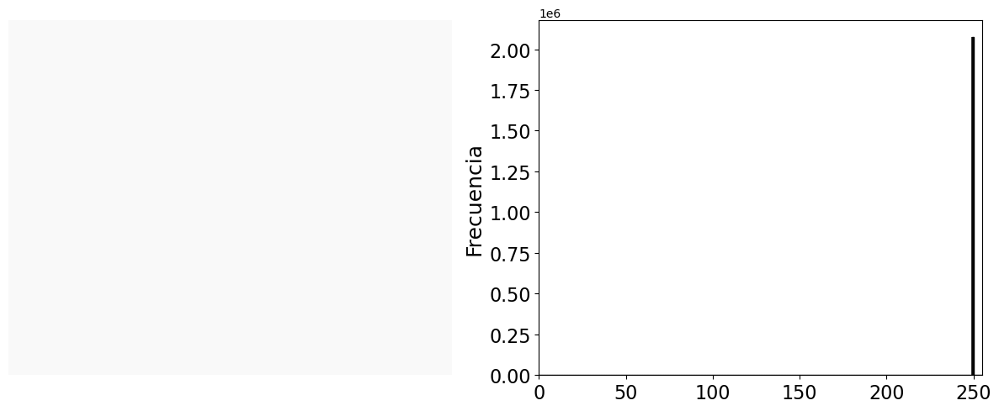

2073600


In [73]:
black_deciph = Image.fromarray(white_undo[0])
black_deciphHist=ciphers.plot_image_and_histogram(black_deciph)
print(np.sum(black_deciphHist[1]))

/Users/gaelsegura/anaconda3/lib/python3.11/site-packages/skimage/metrics/_structural_similarity.py:251: RuntimeWarning: invalid value encountered in divide
  S = (A1 * A2) / D


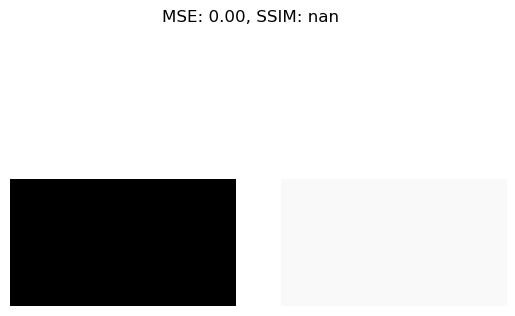

In [74]:
compare_images(white_img,black_deciph)

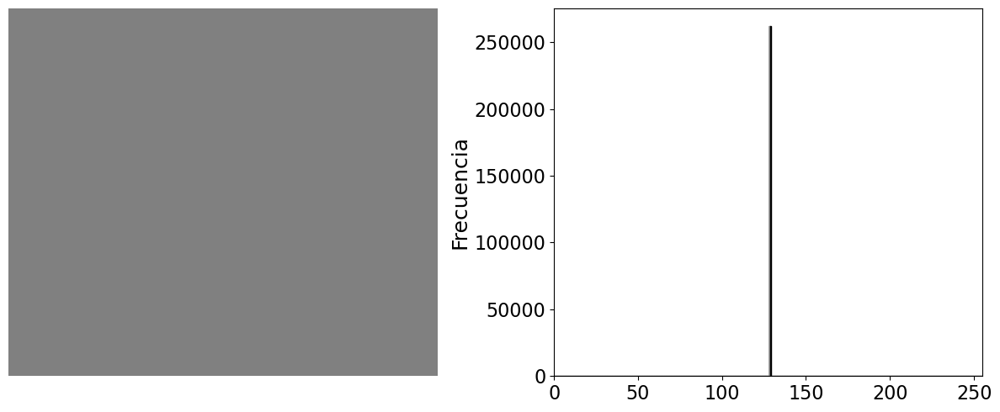

In [3]:
black_arr = np.full((512,512),128,dtype=np.int8)
black_img = Image.fromarray(black_arr)
blackHist=ciphers.plot_image_and_histogram(black_img)

In [4]:
black_cipher_arr,black_xinits,black_rot_cont,black_sboxes = ciphers.enigmarot_cipher(black_img,xinits,params) 

Time:
0.5114367008209229
End, rotcont:
4 0 262144


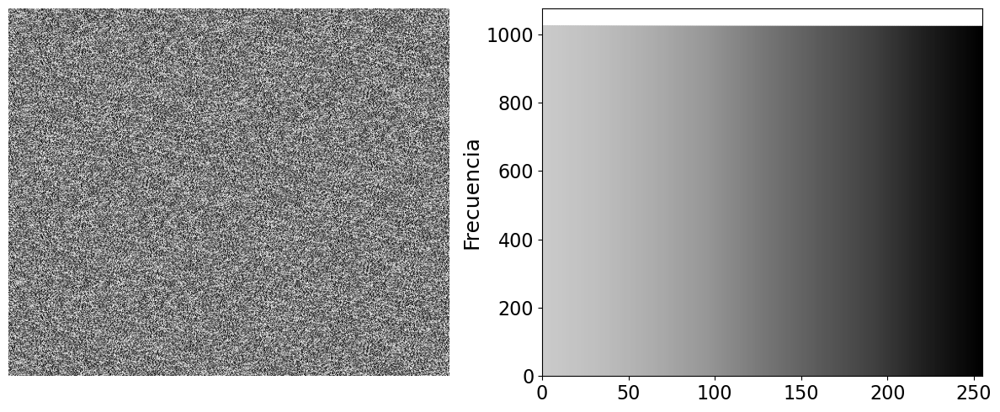

262144


In [5]:
black_ciph = Image.fromarray(black_cipher_arr)
black_ciphHist=ciphers.plot_image_and_histogram(black_ciph)
print(np.sum(black_ciphHist[1]))

In [6]:
bll = Image.fromarray(black_cipher_arr)
doublecipher = ciphers.enigmarot_cipher(black_ciph,black_xinits,params)

Time:
0.5104990005493164
End, rotcont:
4 0 262144


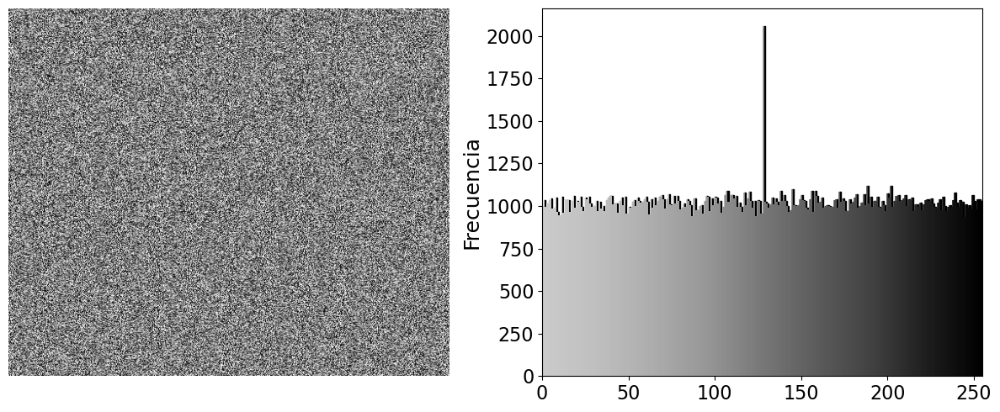

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [7]:
ciphers.plot_image_and_histogram(doublecipher[0])

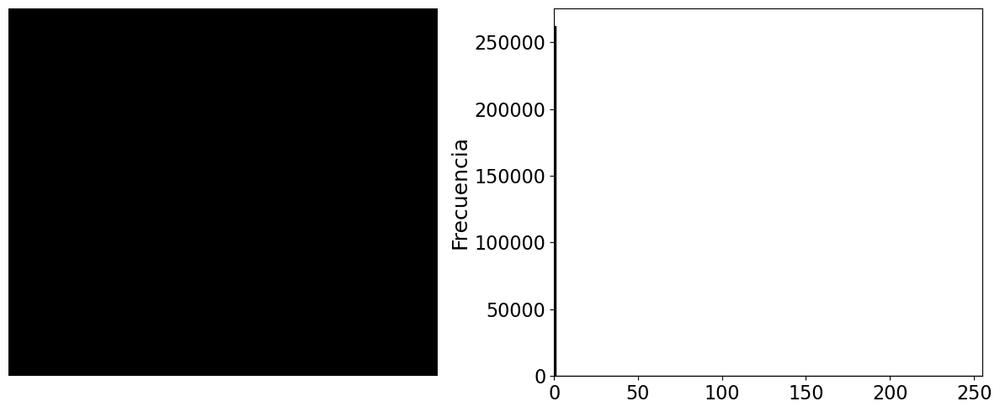

In [8]:
black_arr = np.full((512,512),0,dtype=np.int8)
black_img = Image.fromarray(black_arr)
blackHist=ciphers.plot_image_and_histogram(black_img)

In [9]:
black_cipher_arr,black_xinits,black_rot_cont,black_sboxes = ciphers.enigmarot_cipher(black_img,xinits,params) 

Time:
0.49892401695251465
End, rotcont:
4 0 262144


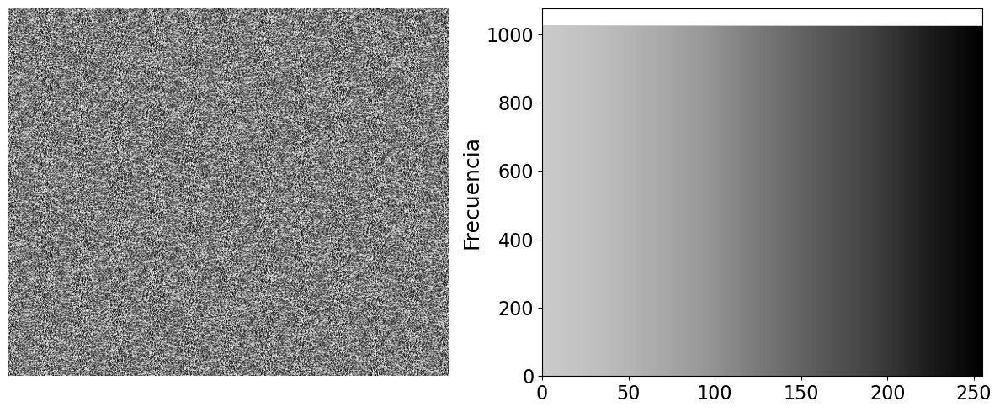

262144


In [10]:
black_ciph = Image.fromarray(black_cipher_arr)
black_ciphHist=ciphers.plot_image_and_histogram(black_ciph)
print(np.sum(black_ciphHist[1]))

In [11]:
bll = Image.fromarray(black_cipher_arr)
doublecipher = ciphers.enigmarot_cipher(black_ciph,black_xinits,params)

Time:
0.5044629573822021
End, rotcont:
4 0 262144


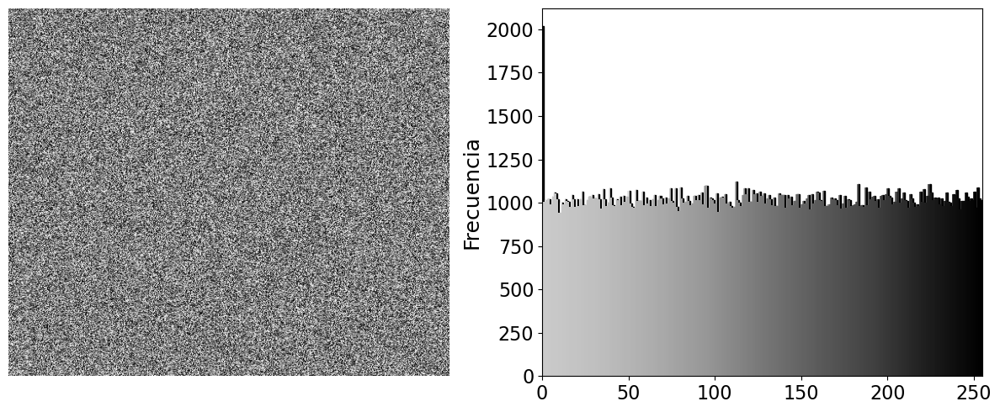

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [12]:
ciphers.plot_image_and_histogram(doublecipher[0])

In [28]:
black_undo = ciphers.enigmarot_decipher(black_ciph,black_xinits,params)

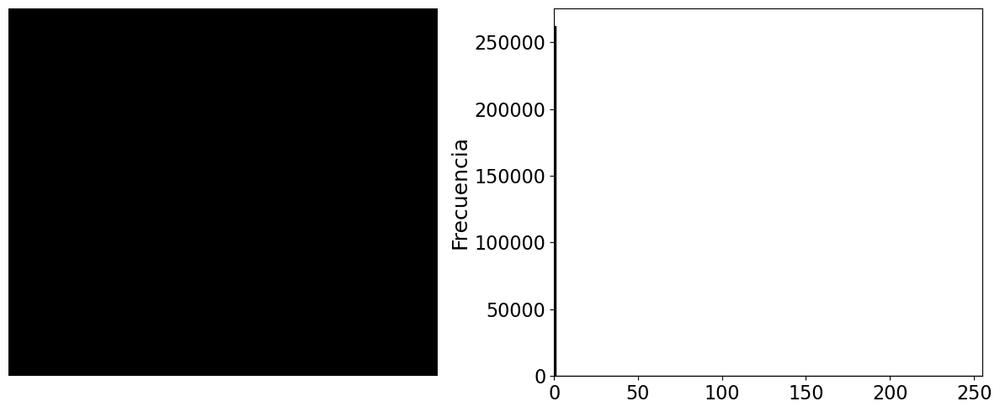

262144


In [29]:
black_deciph = Image.fromarray(black_undo[0])
black_deciphHist=ciphers.plot_image_and_histogram(black_deciph)
print(np.sum(black_deciphHist[1]))

In [ ]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
testttt = ciphers.enigmarot_cipher(lena_img,xinits)
deciphtest = ciphers.enigmarot_decipher(testttt[0],testttt[1])

In [5]:
m2_params = np.random.random_integers(2000,10000,2)/1000
m2_params

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_1221/743518140.py:1: DeprecationWarning: This function is deprecated. Please call randint(2000, 10000 + 1) instead
  m2_params = np.random.random_integers(2000,10000,2)/1000


array([8.326, 5.632])

In [6]:
def pwlm(x,m1=0.8,m2=5,b1=40.8):
    a = b1/m1
    b2 = b1*(m2/m1)
    if x<=-a: return m1*x + b1 
    elif x>-a and x<0: return m2*x + b2
    elif x>=0 and x<a: return m2*x - b2
    elif x>=a: return m1*x - b1 

def generate_sborbit(x0, desired_length=256, m1=0.8, m2=5, b1=40.8):
    orbit = []
    x = x0
    while len(orbit) < desired_length:
        x = pwlm(x, m1, m2, b1)
        x_int = math.floor(x) % 256  # Apply floor and mod 256
        if x_int not in orbit:  # Avoid repetitions
            orbit.append(x_int)
    return orbit

def generate_sbox(x01,x02,delay=10,f1=[0.8,5,40.8],f2=[0.9,4,31]):
    x1 = [x01]
    x2 = [x02]
    m1_seq = 0
    m2_seq = 0
    delayhf = int(delay*0.5)
    sb = []

    i = 0
    while len(sb) < 256:
        x1.append(pwlm(x1[i],f1[0],f1[1],f1[2])) #x1(n+1)=f(x1(n))
        x2.append(pwlm(x2[i],f2[0],f2[1],f2[2]))

        if i>= delay:
            m1_seq = (x1[int(i-(delay))]+x1[int(i-(delayhf))]+x1[int(i)])%256
            m2_seq = (x2[int(i-(delay))]+x2[int(i-(delayhf+1))]+x2[int(i)])%256
            Zi = math.floor((m1_seq+m2_seq)%256)
            if Zi not in sb: sb.append(Zi)

        i+=1
            
    return sb

def alberti_cipher(image):
    arr = np.array(image)
    n = arr.shape[0]
    m = arr.shape[1]
    
    encode_arr = np.zeros((n,m))

    for i in range(n):
        x01,x02 = random.randint(0,255),random.randint(0,255)
        m1_params = np.random.random_integers(8000,10000,2)/10000
        m2_params = np.random.random_integers(2000,10000,2)/1000
        b1_params = np.random.random_integers(8000,50000,2)/1000
        func1 = [m1_params[0],m2_params[0],b1_params[0]]
        func2 = [m1_params[1],m2_params[1],b1_params[1]]
        sb = generate_sbox(x01,x02,10,func1,func2)
        for j in range(m):    
            encode_arr[i,j] = sb[arr[i,j]]
        
    return encode_arr

def encode_image(image, sbox):
    # Primera ronda: dirección directa (de izquierda a derecha, de arriba hacia abajo)
    rows, cols = np.shape(image)
    for i in range(rows):
        for j in range(cols):
            pixel_value = image[i, j]
            image[i, j] = sbox[pixel_value]

    return image

def encode2round_image(image, sbox):
    rows, cols = image.shape
    for i in range(rows):
        for j in range(cols):
            pixel_value = image[i, j]
            image[i, j] = sbox[pixel_value]  # Sustitución con la S-box

    # Segunda ronda: dirección inversa (de derecha a izquierda, de abajo hacia arriba)
    for i in range(rows - 1, -1, -1):
        for j in range(cols - 1, -1, -1):
            pixel_value = image[i, j]
            image[i, j] = sbox[pixel_value]  # Sustitución con la S-box

    return image

def plot_image_and_histogram(image_array):
    # Calcular el histograma
    histogram, bins = np.histogram(image_array, bins=256, range=(0, 256))

    # Crear la figura y los ejes
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))


    cm = plt.cm.get_cmap('Greys')
    # Mostrar la imagen en blanco y negro
    axs[0].imshow(image_array, cmap='gray', aspect='auto')
    axs[0].axis('off')
    #axs[0].set_title("Imagen en blanco y negro")

    # Mostrar el histograma
    axs[1].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
    axs[1].set_xlim(0, 255)
    #axs[1].set_title("Histograma")
    #axs[1].set_xlabel("Intensidad de Gris")
    axs[1].set_ylabel("Frecuencia",fontsize=18)


    #Crear la barra de escala de grises debajo del histograma
    x_span = bins.max()-bins.min()
    C = [cm(((x-bins.min())/x_span)) for x in bins]
    axs[1].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)

    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.tight_layout()
    plt.show()
    
    return bins,histogram

def plot_histogram(image):

    image_array = np.array(image)

    # Calcular el histograma
    histogram, bins = np.histogram(image_array, bins=256, range=(0, 256))

    fig = plt.figure(figsize=(6,5))
    ax = fig.add_subplot()

    ax.bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
    ax.set_xlim(0, 255)
    #axs[1].set_title("Histograma")
    #axs[1].set_xlabel("Intensidad de Gris")
    
    ax.set_ylabel("Frecuencia",fontsize=17)


    #Crear la barra de escala de grises debajo del histograma
    x_span = bins.max()-bins.min()
    cm = plt.cm.get_cmap('Greys')
    C = [cm(((x-bins.min())/x_span)) for x in bins]
    ax.bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)


    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.tight_layout()
    plt.show()

    return fig,ax

def plot_image(image):
    image_array = np.array(image)

    fig = plt.figure()
    ax = fig.add_subplot()

    ax.imshow(image_array, cmap='gray')
    ax.axis('off')

    plt.tight_layout()
    plt.show()

def calculate_pixel_correlation(image):
   
    image_array = np.array(image, dtype=np.float64)
    
    # Correlación horizontal
    corr_horz = pearsonr(
        image_array[:, :-1].flatten(),  # Todos los píxeles excepto el último de cada fila
        image_array[:, 1:].flatten()   # Todos los píxeles excepto el primero de cada fila
    )[0]
    
    # Correlación vertical
    corr_vert = pearsonr(
        image_array[:-1, :].flatten(),  # Todos los píxeles excepto el último de cada columna
        image_array[1:, :].flatten()   # Todos los píxeles excepto el primero de cada columna
    )[0]
    
    # Correlación diagonal
    corr_diag = pearsonr(
        image_array[:-1, :-1].flatten(),  # Todos los píxeles excepto los de la última fila y columna
        image_array[1:, 1:].flatten()    # Todos los píxeles excepto los de la primera fila y columna
    )[0]
    
    return {
        "Horizontal": np.round(corr_horz,5),
        "Vertical": np.round(corr_vert,5),
        "Diagonal": np.round(corr_diag,5),
        "Avg": np.round((corr_diag+corr_horz+corr_vert)/3,5)
    }

def calculate_image_entropy(image):
    entropy=0
    img_arr = np.array(image)
    hist,_ = np.histogram(img_arr, bins=256, range=(0, 255), density=True)
    
    for i in range(len(hist)-1):    
        if hist[i]>0:
            entropy += hist[i]*np.log2(1/hist[i])
        else: continue

    
    return entropy

def mse(imageA, imageB):
	# the 'Mean Squared Error' between the two images is the
	# sum of the squared difference between the two images;
	# the two images must have the same dimension
	err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1])
	# err = np.sqrt(err)
	# return the MSE, the lower the error, the more "similar"
	# the two images are
	return err

def psnr(imageA,imageB):
	mse_val = mse(imageA,imageB)
	psnr_val = 10*np.log10((255**2)/mse_val)#np.sqrt(mse_val))
	return mse_val,psnr_val



In [207]:
np.max(lena_img)

255

In [7]:
sbox_aes = Sbox(aes_sbox)
sbox_cassal = Sbox(sbox_logistic)
sbox_marce = Sbox(sbmarce)
sbox_pwlm = Sbox(sbox_mixedtseries)
sbox_latest = Sbox(sb_ediesca)
# sbox_skipjack = Sbox(sbox_skipjack)

In [8]:
def enigmarot_cipher(image,xinits):
    k=3
    img_array = np.array(image)
    n,m = img_array.shape[0],img_array.shape[1]
    sboxes = [Sbox(generate_sbox(xinits[i][0],xinits[i][1])) for i in range(k)]
    print(sboxes[0].table)
    print(sboxes[1].table)
    print(sboxes[2].table)
    
    cipher_arr = np.zeros((n,m))
    rot_cont = [0]*3

    for c in range(n):
        for r in range(m):
            aux = sboxes[0].table[img_array[c,r]]
            aux = sboxes[1].table[aux]
            aux = sboxes[2].table[aux]
            cipher_arr[c,r] = aux
            sboxes[k-1].rotation()
            rot_cont[k-1]=sboxes[k-1].rot_cont
            if rot_cont[k-1]%256==0 and rot_cont[k-1]!=0:      
                sboxes[k-2].rotation()
                rot_cont[k-2]+=1
                # print("Rot 2:")
                # print(sboxes[k-2].table)
                # print(rot_cont)
            
            if rot_cont[k-2]%256==0 and rot_cont[k-2]!=0:
                sboxes[k-3].rotation()
                rot_cont[k-3]=sboxes[k-3].rot_cont
                rot_cont[k-2]=0
                # print("Rot 3:")
                # print(sboxes[k-3].table)
                # print(rot_cont)
                

            if rot_cont[k-3]%256==0 and rot_cont[k-3]!=0:
                print("ya es toda we ",sboxes[k-3].rot_cont)
    print("End")
    sboxes[0].reset_table()
    sboxes[1].reset_table()
    sboxes[2].reset_table()
    print(sboxes[0].table)
    print(sboxes[1].table)
    print(sboxes[2].table)
        
    return cipher_arr,xinits,rot_cont,sboxes

def enigmarot_decipher(image,xinits):
    k=3
    img_array = np.array(image)
    n,m = img_array.shape[0],img_array.shape[1]
    # xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(k)]
    sboxes = [Sbox(generate_sbox(x[1][0],x[1][1])) for x in enumerate(xinits)]
    
    decipher_arr = np.zeros((n,m))
    rot_cont = [0]*3

    for c in range(n):
        for r in range(m):
            aux = sboxes[2].table.index(img_array[c,r])
            aux = sboxes[1].table.index(aux)
            aux = sboxes[0].table.index(aux)
            decipher_arr[c,r] = aux
            sboxes[k-1].rotation()
            rot_cont[k-1]=sboxes[k-1].rot_cont
            if rot_cont[k-1]%256==0 and rot_cont[k-1]!=0:      
                sboxes[k-2].rotation()
                rot_cont[k-2]+=1
                # print("Rot 2:")
                # print(sboxes[k-2].table)
                # print(rot_cont)
            
            if rot_cont[k-2]%256==0 and rot_cont[k-2]!=0:
                sboxes[k-3].rotation()
                rot_cont[k-3]=sboxes[k-3].rot_cont
                rot_cont[k-2]=0
                # print("Rot 3:")
                # print(sboxes[k-3].table)
                # print(rot_cont)
                

            if rot_cont[k-3]%256==0 and rot_cont[k-3]!=0:
                print("ya es toda we ",sboxes[k-3].rot_cont)
        
    return decipher_arr,xinits,rot_cont,sboxes

In [17]:
print(np.shape(testttt[0]),np.shape(deciphtest[0]),np.shape(testttt[1]),np.shape(deciphtest[1]))
print(np.sum(histogram),np.sum(dec_histogram))

(256, 256) (256, 256) (3, 2) (3, 2)
65536 65536


In [1]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
testttt = enigmarot_cipher(lena_img,xinits)
deciphtest = enigmarot_decipher(testttt[0],testttt[1])

fig,axs = plt.subplots(2,2,figsize=(12, 10))

axs[0,0].imshow(testttt[0], cmap='gray', aspect='auto')
axs[0,0].axis('off')
axs[0,1].imshow(deciphtest[0], cmap='gray', aspect='auto')
axs[0,1].axis('off')

histogram, bins = np.histogram(testttt[0], bins=256, range=(0, 256))
dec_histogram, dec_bins = np.histogram(deciphtest[0], bins=256, range=(0, 256))

#Crear la barra de escala de grises debajo del histograma
x_span = bins.max()-bins.min()
cm = plt.cm.get_cmap('Greys')
C = [cm(((x-bins.min())/x_span)) for x in bins]

axs[1,0].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,0].set_xlim(0, 255)
axs[1,0].set_ylabel("Frecuencia",fontsize=18)

axs[1,1].bar(dec_bins[:-1], dec_histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,1].set_xlim(0, 255)
axs[1,1].set_ylabel("Frecuencia",fontsize=18)

x_span = bins.max()-bins.min()
C = [cm(((x-bins.min())/x_span)) for x in bins]
axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
axs[1,1].bar(dec_bins[:-1], dec_histogram, width=dec_bins[1]-dec_bins[0], color=C, alpha=0.8)

# axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
# axs[1,1].bar(dec_bins[:-1], dec_histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()

NameError: name 'np' is not defined

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_1221/221475919.py:95: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


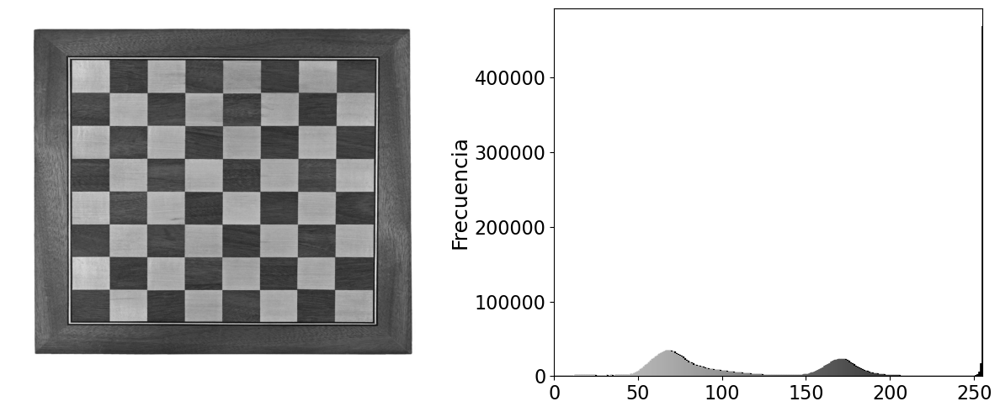

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [19]:
plot_image_and_histogram(chess_img)

[159, 102, 190, 43, 130, 42, 238, 67, 99, 246, 240, 235, 74, 254, 247, 202, 186, 96, 187, 20, 160, 36, 17, 100, 208, 250, 4, 132, 128, 151, 237, 179, 104, 9, 181, 174, 211, 234, 66, 129, 1, 105, 215, 196, 158, 184, 162, 50, 217, 126, 60, 119, 109, 177, 219, 236, 22, 155, 222, 55, 197, 58, 251, 32, 115, 40, 101, 210, 26, 34, 12, 108, 154, 62, 118, 111, 46, 171, 248, 140, 232, 106, 173, 175, 70, 78, 85, 64, 200, 44, 82, 103, 188, 189, 138, 112, 139, 214, 120, 161, 52, 218, 0, 92, 172, 209, 185, 220, 147, 48, 178, 71, 176, 226, 163, 79, 56, 93, 137, 57, 164, 169, 144, 131, 90, 5, 89, 227, 33, 199, 191, 27, 224, 53, 94, 123, 15, 63, 6, 192, 149, 35, 95, 107, 182, 133, 206, 61, 76, 37, 244, 29, 86, 204, 73, 230, 229, 75, 127, 19, 205, 165, 97, 121, 157, 203, 183, 150, 87, 80, 54, 225, 38, 14, 212, 167, 10, 13, 156, 213, 253, 110, 255, 243, 83, 28, 216, 24, 145, 31, 68, 193, 91, 81, 168, 241, 242, 49, 170, 198, 59, 84, 113, 239, 134, 221, 124, 231, 135, 41, 88, 152, 16, 117, 30, 195, 45, 148

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_1221/1867678695.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


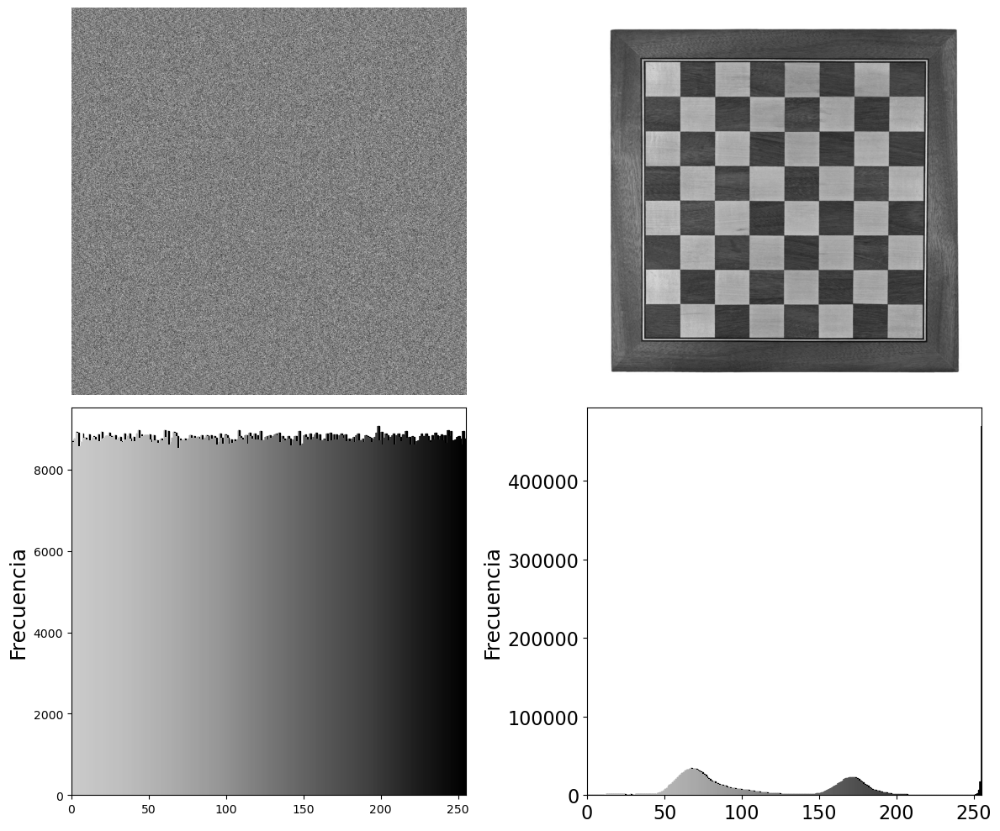

In [20]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
testttt = enigmarot_cipher(chess_img,xinits)
deciphtest = enigmarot_decipher(testttt[0],testttt[1])

fig,axs = plt.subplots(2,2,figsize=(12, 10))

axs[0,0].imshow(testttt[0], cmap='gray', aspect='auto')
axs[0,0].axis('off')
axs[0,1].imshow(deciphtest[0], cmap='gray', aspect='auto')
axs[0,1].axis('off')

histogram, bins = np.histogram(testttt[0], bins=256, range=(0, 256))
dec_histogram, dec_bins = np.histogram(deciphtest[0], bins=256, range=(0, 256))

#Crear la barra de escala de grises debajo del histograma
x_span = bins.max()-bins.min()
cm = plt.cm.get_cmap('Greys')
C = [cm(((x-bins.min())/x_span)) for x in bins]

axs[1,0].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,0].set_xlim(0, 255)
axs[1,0].set_ylabel("Frecuencia",fontsize=18)

axs[1,1].bar(dec_bins[:-1], dec_histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,1].set_xlim(0, 255)
axs[1,1].set_ylabel("Frecuencia",fontsize=18)

x_span = bins.max()-bins.min()
C = [cm(((x-bins.min())/x_span)) for x in bins]
axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
axs[1,1].bar(dec_bins[:-1], dec_histogram, width=dec_bins[1]-dec_bins[0], color=C, alpha=0.8)

# axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
# axs[1,1].bar(dec_bins[:-1], dec_histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()

In [23]:
print(np.sum(histogram),np.sum(dec_histogram),np.size(chess_arr))

2250000 2250000 2250000


# Alberti Cipher corrected (changing m1,m2,b1)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/221475919.py:51: DeprecationWarning: This function is deprecated. Please call randint(8000, 10000 + 1) instead
  m1_params = np.random.random_integers(8000,10000,2)/10000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/221475919.py:52: DeprecationWarning: This function is deprecated. Please call randint(2000, 10000 + 1) instead
  m2_params = np.random.random_integers(2000,10000,2)/1000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/221475919.py:53: DeprecationWarning: This function is deprecated. Please call randint(8000, 50000 + 1) instead
  b1_params = np.random.random_integers(8000,50000,2)/1000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/4262176721.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead

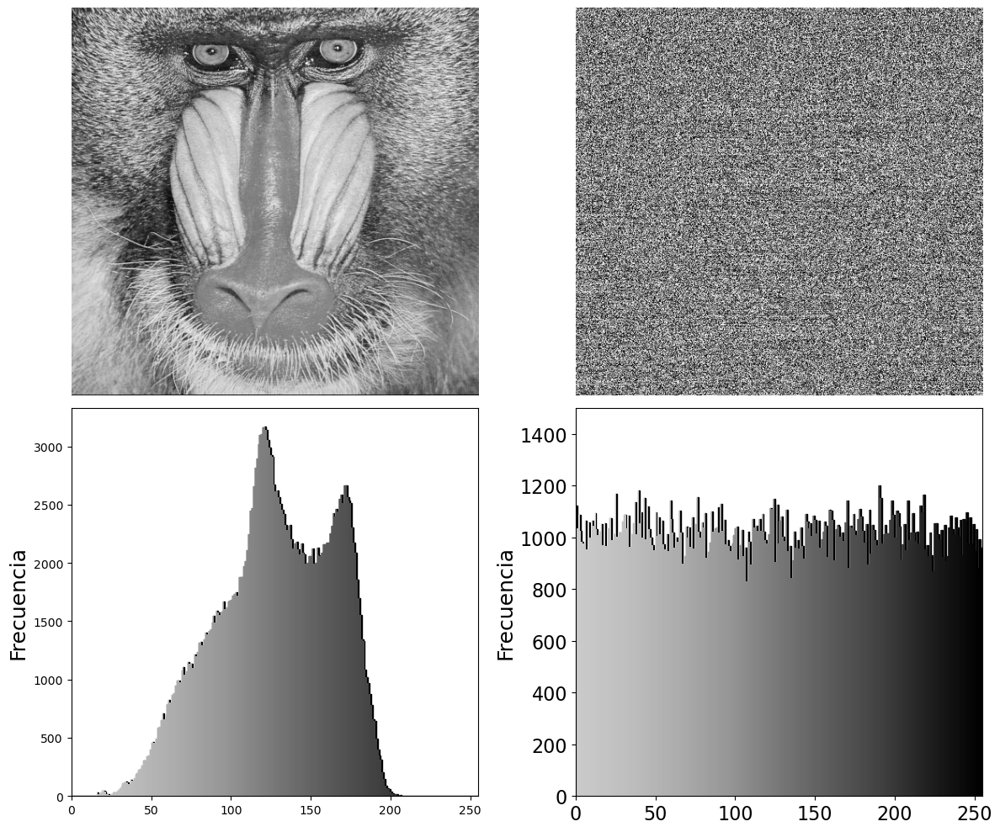

In [215]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
test_alberti = alberti_cipher(baboon_img)

cipher_alberti = Image.fromarray(test_alberti).convert("L")
histogram, bins = np.histogram(baboon_arr, bins=256, range=(0, 256))
cip_histogram, cip_bins = np.histogram(test_alberti, bins=256, range=(0, 256))

fig,axs = plt.subplots(2,2,figsize=(12, 10))

axs[0,0].imshow(baboon_img, cmap='gray', aspect='auto')
axs[0,0].axis('off')
axs[0,1].imshow(cipher_alberti, cmap='gray', aspect='auto')
axs[0,1].axis('off')


#Crear la barra de escala de grises debajo del histograma
x_span = bins.max()-bins.min()
cm = plt.cm.get_cmap('Greys')
C = [cm(((x-bins.min())/x_span)) for x in bins]

axs[1,0].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,0].set_xlim(0, 255)
# axs[1,0].set_ylim(0, 500)
axs[1,0].set_ylabel("Frecuencia",fontsize=18)

axs[1,1].bar(cip_bins[:-1], cip_histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,1].set_xlim(0, 255)
axs[1,1].set_ylim(0, 1500)
axs[1,1].set_ylabel("Frecuencia",fontsize=18)

x_span = bins.max()-bins.min()
C = [cm(((x-bins.min())/x_span)) for x in bins]
axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
axs[1,1].bar(cip_bins[:-1], cip_histogram, width=cip_bins[1]-cip_bins[0], color=C, alpha=0.8)

# axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
# axs[1,1].bar(dec_bins[:-1], dec_histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
test_alberti = ciphers.enigmarot_cipher(lena_img,)

cipher_alberti = Image.fromarray(test_alberti).convert("L")
histogram, bins = np.histogram(lena_arr, bins=256, range=(0, 256))
cip_histogram, cip_bins = np.histogram(test_alberti, bins=256, range=(0, 256))
ciphers.plot_image(cipher_alberti)

TypeError: enigmarot_cipher() missing 2 required positional arguments: 'xinits' and 'params'

In [219]:
# resrmse = mse(baboon_img,cipher_alberti)
respsnr = psnr(baboon_arr,test_alberti)
rescorr = calculate_pixel_correlation(cipher_alberti)
resentr = calculate_image_entropy(cipher_alberti)
print(rescorr,np.round(resentr,5),respsnr) 

{'Horizontal': 0.03499, 'Vertical': 0.00039, 'Diagonal': -0.00248, 'Avg': 0.01097} 7.99306 (6777.358428955078, 9.820199064214751)


In [ ]:
# resrmse = mse(baboon_img,cipher_alberti)
baboon_ediesca = Image.open("/Users/gaelsegura/Documents/codes/SBOXEDIESCA2025/Figures/baboon_alberticiph.jpg")
ediesca_Arr = np.array(baboon_ediesca)
respsnr = psnr(baboon_arr,ediesca_Arr)
rescorr = calculate_pixel_correlation(ediesca_Arr)
resentr = calculate_image_entropy(ediesca_Arr)
print(rescorr,resentr,respsnr) 

In [218]:
new = cipher_alberti.convert("L")
new.save("baboon_alberticiph.jpg")

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/221475919.py:141: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


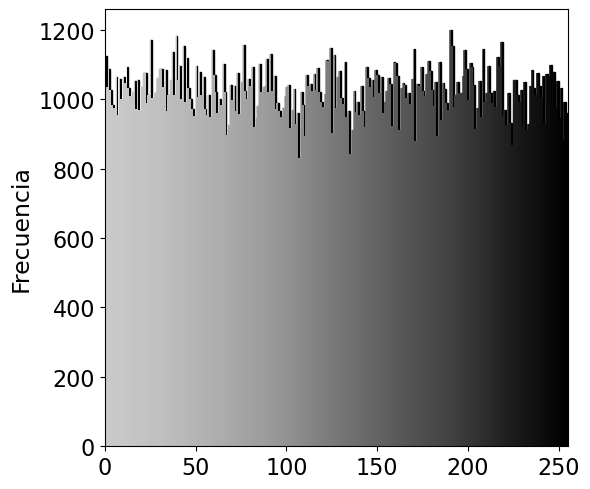

(<Figure size 600x500 with 1 Axes>, <Axes: ylabel='Frecuencia'>)

In [217]:
plot_histogram(cipher_alberti)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/2415599279.py:51: DeprecationWarning: This function is deprecated. Please call randint(8000, 10000 + 1) instead
  m1_params = np.random.random_integers(8000,10000,2)/10000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/2415599279.py:52: DeprecationWarning: This function is deprecated. Please call randint(2000, 10000 + 1) instead
  m2_params = np.random.random_integers(2000,10000,2)/1000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/2415599279.py:53: DeprecationWarning: This function is deprecated. Please call randint(8000, 50000 + 1) instead
  b1_params = np.random.random_integers(8000,50000,2)/1000
/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/2763916509.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` inst

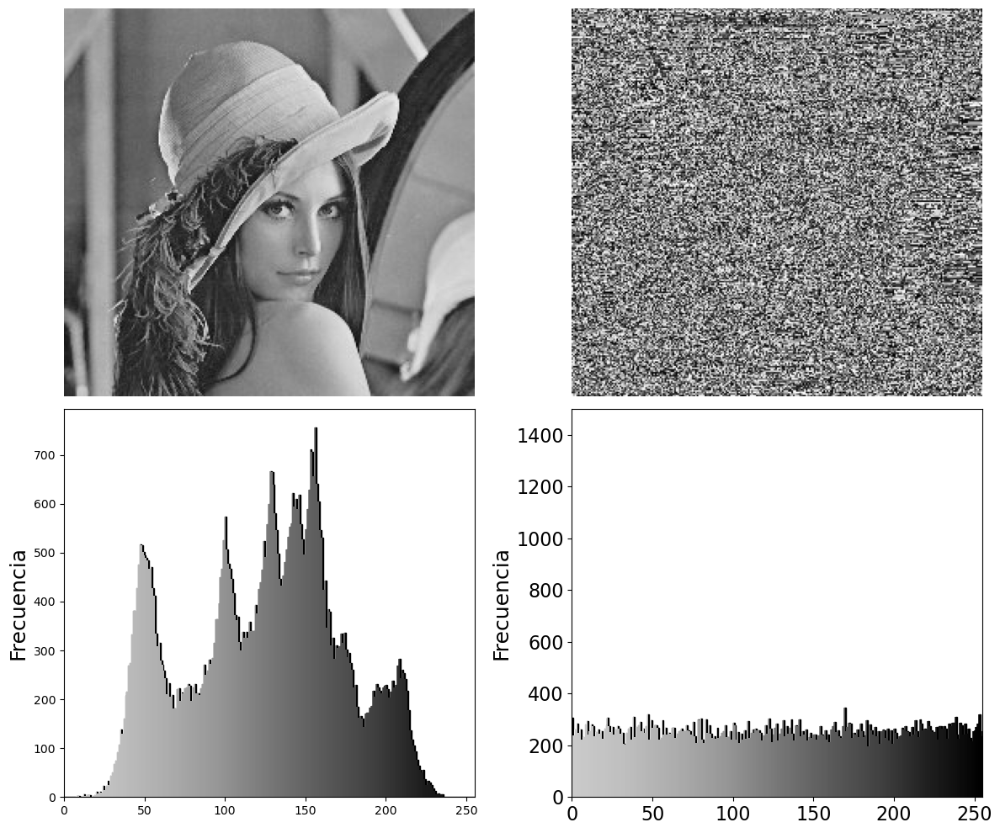

In [ ]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
alberti_lena = alberti_cipher(lena_img)

imgalberti_lena = Image.fromarray(alberti_lena).convert("L")
histogram, bins = np.histogram(lena_arr, bins=256, range=(0, 256))
cip_histogram, cip_bins = np.histogram(alberti_lena, bins=256, range=(0, 256))

fig,axs = plt.subplots(2,2,figsize=(12, 10))

axs[0,0].imshow(lena_img, cmap='gray', aspect='auto')
axs[0,0].axis('off')
axs[0,1].imshow(imgalberti_lena, cmap='gray', aspect='auto')
axs[0,1].axis('off')


#Crear la barra de escala de grises debajo del histograma
x_span = bins.max()-bins.min()
cm = plt.cm.get_cmap('Greys')
C = [cm(((x-bins.min())/x_span)) for x in bins]

axs[1,0].bar(bins[:-1], histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,0].set_xlim(0, 255)
# axs[1,0].set_ylim(0, 500)
axs[1,0].set_ylabel("Frecuencia",fontsize=18)

axs[1,1].bar(cip_bins[:-1], cip_histogram, width=1, color='black', edgecolor='black', align='edge')
axs[1,1].set_xlim(0, 255)
# axs[1,1].set_ylim(0, 1500)
axs[1,1].set_ylabel("Frecuencia",fontsize=18)

x_span = bins.max()-bins.min()
C = [cm(((x-bins.min())/x_span)) for x in bins]
axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
axs[1,1].bar(cip_bins[:-1], cip_histogram, width=cip_bins[1]-cip_bins[0], color=C, alpha=0.8)

# axs[1,0].bar(bins[:-1], histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
# axs[1,1].bar(dec_bins[:-1], dec_histogram, width=bins[1]-bins[0], color=C, alpha=0.8)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()

In [221]:
respsnr = psnr(lena_arr,alberti_lena)
rescorr = calculate_pixel_correlation(cipher_alberti)
resentr = calculate_image_entropy(cipher_alberti)
print(rescorr,resentr,respsnr) 

{'Horizontal': 0.03499, 'Vertical': 0.00039, 'Diagonal': -0.00248, 'Avg': 0.01097} 7.993064945101553 (7902.550643920898, 9.153130731478258)


In [ ]:
def zigzag_transform(sbox):
    """
    Aplica la transformación zigzag a una S-box de 16x16 (256 elementos).
    
    Args:
        sbox (list): Lista de 256 elementos representando la S-box en orden por filas.
    
    Returns:
        list: Nueva S-box transformada en orden zigzag.
    """
    n = 16  # Tamaño de la matriz (16x16)
    # Generar secuencia de índices (i, j) en orden zigzag
    zigzag_path = []
    i, j = 0, 0
    up = True
    total = n * n
    
    for _ in range(total):
        zigzag_path.append((i, j))
        
        if up:  # Movimiento en diagonal hacia arriba-derecha
            if i > 0 and j < n - 1:
                i -= 1
                j += 1
            else:
                up = False
                if j < n - 1:
                    j += 1
                else:
                    i += 1
        else:  # Movimiento en diagonal hacia abajo-izquierda
            if j > 0 and i < n - 1:
                i += 1
                j -= 1
            else:
                up = True
                if i < n - 1:
                    i += 1
                else:
                    j += 1
    
    # Construir nueva S-box usando el orden zigzag
    new_sbox = [sbox[i * n + j] for (i, j) in zigzag_path]
    return new_sbox

transformed_sbox = zigzag_transform(sb_ediesca)

# Verificar primeros 10 elementos
print("Original (primeros 10):", sb_ediesca[:10])
print("Transformada (primeros 10):", transformed_sbox[:10])

sb_pwlpluszigzag = Sbox(transformed_sbox)
og_ediescasbox = Sbox(sb_ediesca)


Original (primeros 10): [243, 130, 238, 170, 157, 85, 151, 139, 164, 253]
Transformada (primeros 10): [243, 130, 74, 199, 0, 238, 170, 31, 51, 209]


NameError: name 'Sbox' is not defined

In [40]:
# x01,x02 = np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)
sbteset2 = Sbox(generate_sbox(10))

NameError: name 'Sbox' is not defined

In [ ]:
nlresult = sbteset2.nonlinearity_analysis()
sacresult=sbteset2.sac_analysis()
bicsacavg = sbteset2.bic_average(sbteset2.bicsac_analysis())[0]
bicnlavg = sbteset2.bic_average(sbteset2.bicnonl_analysis())[0]

In [ ]:
print(np.min(sacresult),np.max(sacresult),np.average(sacresult))
print(np.min(nlresult),np.max(nlresult),np.average(nlresult))
print(bicsacavg)
print(bicnlavg)
print(sbteset2.differential_probability())
print(sbteset2.linear_probability())

0.4062 0.5781 0.5007375000000001
100.0 108.0 104.25
0.5004185267857143
103.57142857142857
0.0390625
0.0625


TypeError: enigmarot_cipher() missing 1 required positional argument: 'params'

[190, 235, 165, 114, 45, 188, 50, 156, 63, 4, 205, 82, 253, 215, 37, 221, 243, 104, 18, 85, 166, 124, 64, 227, 185, 225, 11, 100, 155, 113, 57, 112, 220, 66, 121, 199, 83, 206, 111, 208, 192, 70, 35, 212, 76, 229, 182, 56, 120, 58, 95, 174, 14, 5, 211, 12, 8, 78, 52, 170, 251, 213, 15, 110, 236, 92, 210, 234, 42, 69, 87, 164, 226, 60, 232, 41, 74, 240, 62, 168, 98, 250, 194, 34, 79, 91, 136, 32, 228, 72, 197, 151, 0, 222, 122, 80, 23, 179, 175, 144, 40, 162, 147, 200, 158, 163, 6, 94, 135, 195, 187, 198, 21, 204, 51, 244, 247, 28, 93, 153, 17, 48, 16, 127, 223, 177, 248, 65, 160, 138, 39, 7, 22, 202, 167, 242, 141, 216, 26, 30, 159, 191, 102, 246, 178, 193, 149, 3, 54, 71, 46, 106, 146, 97, 239, 255, 133, 196, 132, 81, 73, 172, 43, 107, 214, 128, 231, 233, 36, 77, 201, 33, 207, 203, 123, 13, 20, 116, 55, 173, 143, 130, 24, 254, 86, 67, 115, 157, 117, 29, 142, 152, 131, 125, 169, 53, 109, 103, 89, 154, 139, 119, 140, 189, 161, 96, 10, 118, 31, 108, 1, 180, 49, 252, 61, 59, 129, 218, 230

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


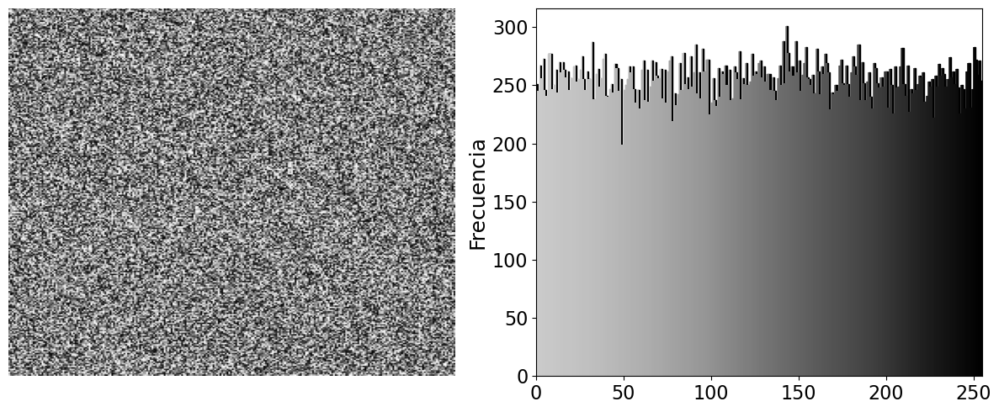

In [ ]:
lena_ciph = enigmarot_cipher(lena_arr)
ciph_arr = Image.fromarray(lena_ciph[0])
bins, hist = plot_image_and_histogram(ciph_arr)

In [ ]:
lena_decipher = enigmarot_decipher(lena_ciph[0],xinits=lena_ciph[1])

[191, 89, 205, 237, 120, 48, 80, 77, 214, 52, 251, 169, 53, 106, 79, 204, 129, 85, 41, 101, 40, 14, 133, 175, 62, 83, 128, 168, 50, 211, 35, 116, 84, 195, 236, 114, 122, 252, 64, 20, 162, 197, 234, 207, 230, 192, 220, 58, 176, 232, 244, 66, 107, 196, 185, 144, 32, 142, 39, 137, 198, 67, 93, 203, 218, 250, 23, 11, 123, 45, 68, 140, 102, 148, 33, 223, 118, 19, 165, 55, 238, 74, 132, 139, 226, 9, 119, 65, 225, 216, 16, 13, 217, 181, 172, 90, 8, 54, 149, 180, 115, 73, 246, 147, 15, 209, 112, 104, 208, 171, 4, 186, 240, 46, 30, 113, 108, 103, 227, 10, 38, 156, 95, 184, 111, 22, 221, 24, 59, 183, 96, 6, 222, 94, 87, 249, 247, 0, 179, 3, 177, 146, 178, 126, 100, 159, 141, 243, 97, 190, 37, 127, 158, 12, 235, 81, 239, 242, 233, 182, 43, 213, 254, 60, 189, 212, 56, 70, 215, 75, 255, 188, 152, 31, 248, 210, 200, 78, 170, 124, 17, 206, 157, 143, 71, 150, 82, 29, 27, 63, 231, 98, 136, 164, 145, 151, 88, 44, 91, 34, 135, 49, 245, 117, 69, 21, 153, 219, 76, 121, 26, 134, 194, 51, 110, 36, 125, 163, 

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


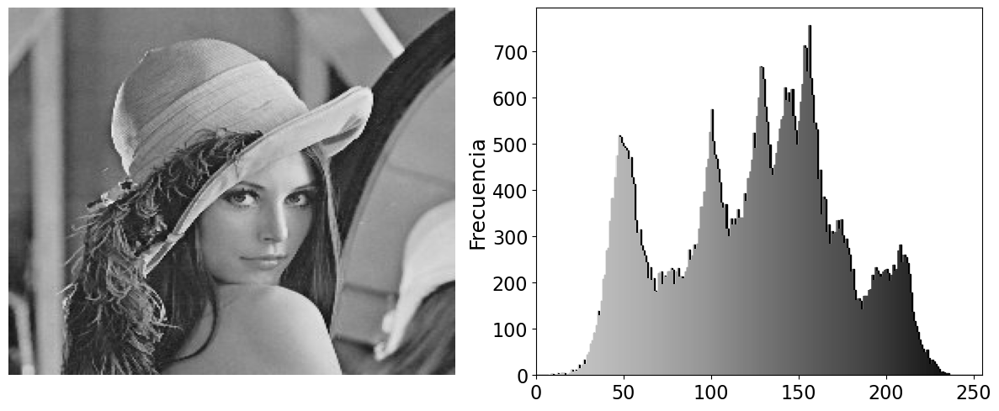

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
plot_image_and_histogram(lena_arr)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


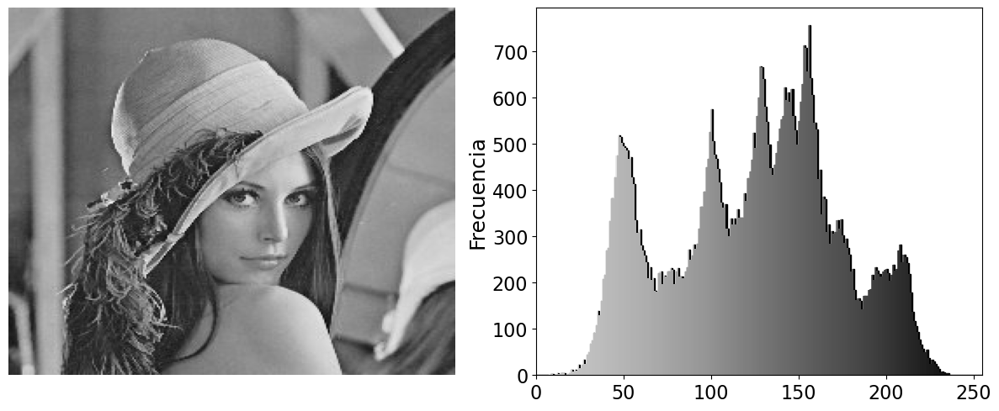

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
plot_image_and_histogram(lena_decipher[0])

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_62029/2117733309.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


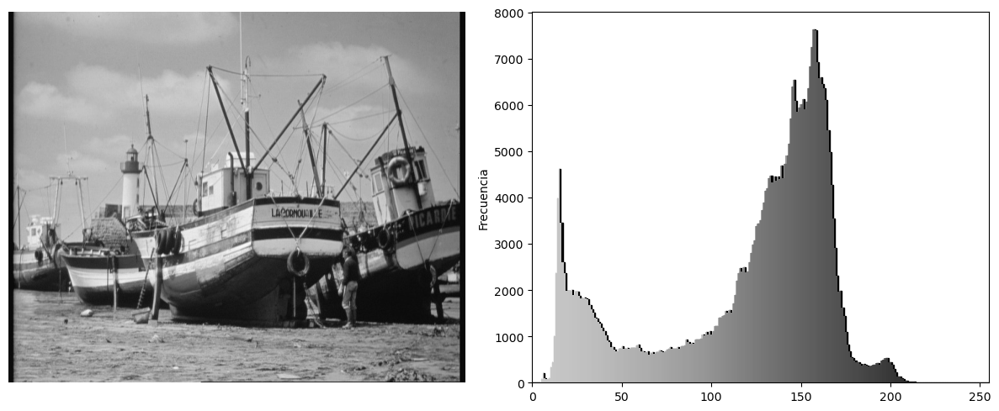

(<Figure size 1200x500 with 2 Axes>,
 array([<Axes: >, <Axes: ylabel='Frecuencia'>], dtype=object))

In [ ]:
plot_image_and_histogram(boats_img)

[236, 249, 188, 137, 99, 150, 121, 4, 232, 230, 246, 211, 7, 34, 209, 195, 25, 229, 84, 70, 23, 67, 108, 16, 192, 65, 227, 94, 78, 97, 12, 147, 165, 37, 226, 143, 55, 179, 140, 43, 87, 20, 75, 201, 193, 168, 156, 183, 210, 29, 77, 223, 68, 169, 106, 1, 30, 31, 52, 176, 113, 2, 56, 252, 14, 171, 203, 235, 181, 123, 163, 115, 8, 215, 57, 114, 128, 19, 148, 202, 28, 178, 116, 64, 152, 149, 247, 127, 139, 117, 231, 146, 174, 88, 81, 184, 122, 54, 21, 191, 213, 120, 62, 251, 233, 200, 170, 41, 102, 245, 241, 66, 240, 0, 45, 221, 255, 145, 103, 13, 217, 216, 219, 22, 119, 58, 53, 109, 155, 138, 85, 47, 74, 100, 96, 51, 237, 180, 134, 144, 104, 187, 132, 36, 76, 205, 90, 166, 129, 32, 186, 79, 224, 248, 40, 82, 48, 93, 86, 112, 162, 3, 239, 214, 89, 27, 38, 24, 206, 83, 98, 153, 243, 63, 254, 107, 125, 11, 46, 69, 228, 222, 35, 15, 212, 185, 238, 154, 95, 161, 105, 110, 218, 189, 157, 33, 172, 80, 18, 175, 182, 72, 17, 159, 71, 199, 136, 244, 10, 197, 130, 6, 5, 142, 234, 242, 39, 208, 118, 1

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


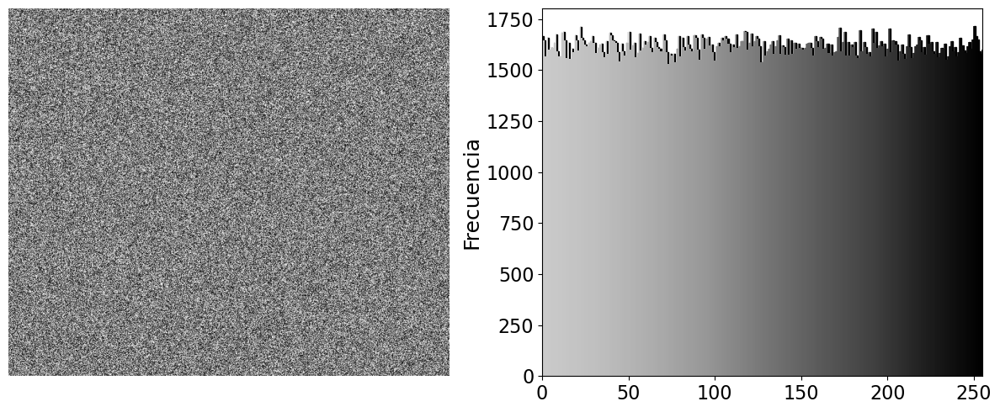

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
boats_ciph = enigmarot_cipher(boats_arr)
boats_imgciph = Image.fromarray(boats_ciph[0])
plot_image_and_histogram(boats_imgciph)

In [ ]:
boats_deciph = enigmarot_decipher(boats_ciph[0],boats_ciph[1])

Rot 2:
[0, 1, 256]
Rot 2:
[0, 2, 512]
Rot 2:
[0, 3, 768]
Rot 2:
[0, 4, 1024]
Rot 2:
[0, 5, 1280]
Rot 2:
[0, 6, 1536]
Rot 2:
[0, 7, 1792]
Rot 2:
[0, 8, 2048]
Rot 2:
[0, 9, 2304]
Rot 2:
[0, 10, 2560]
Rot 2:
[0, 11, 2816]
Rot 2:
[0, 12, 3072]
Rot 2:
[0, 13, 3328]
Rot 2:
[0, 14, 3584]
Rot 2:
[0, 15, 3840]
Rot 2:
[0, 16, 4096]
Rot 2:
[0, 17, 4352]
Rot 2:
[0, 18, 4608]
Rot 2:
[0, 19, 4864]
Rot 2:
[0, 20, 5120]
Rot 2:
[0, 21, 5376]
Rot 2:
[0, 22, 5632]
Rot 2:
[0, 23, 5888]
Rot 2:
[0, 24, 6144]
Rot 2:
[0, 25, 6400]
Rot 2:
[0, 26, 6656]
Rot 2:
[0, 27, 6912]
Rot 2:
[0, 28, 7168]
Rot 2:
[0, 29, 7424]
Rot 2:
[0, 30, 7680]
Rot 2:
[0, 31, 7936]
Rot 2:
[0, 32, 8192]
Rot 2:
[0, 33, 8448]
Rot 2:
[0, 34, 8704]
Rot 2:
[0, 35, 8960]
Rot 2:
[0, 36, 9216]
Rot 2:
[0, 37, 9472]
Rot 2:
[0, 38, 9728]
Rot 2:
[0, 39, 9984]
Rot 2:
[0, 40, 10240]
Rot 2:
[0, 41, 10496]
Rot 2:
[0, 42, 10752]
Rot 2:
[0, 43, 11008]
Rot 2:
[0, 44, 11264]
Rot 2:
[0, 45, 11520]
Rot 2:
[0, 46, 11776]
Rot 2:
[0, 47, 12032]
Rot 2:
[0, 48, 12

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


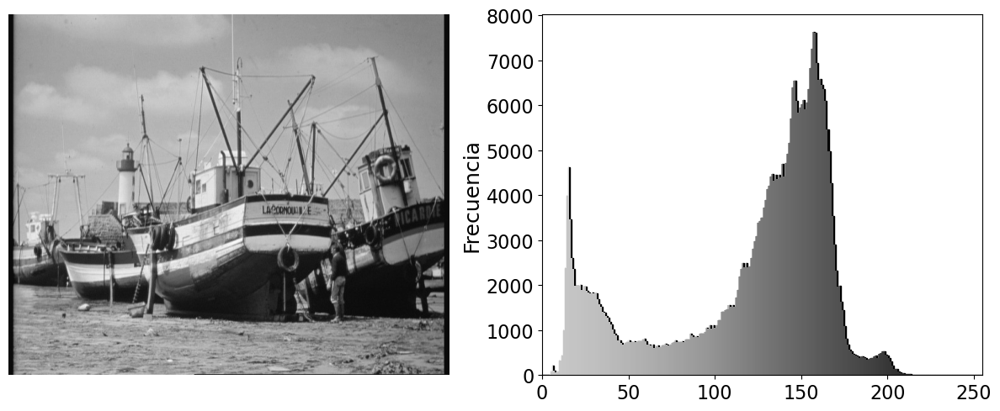

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
plot_image_and_histogram(boats_deciph[0])

[12, 124, 122, 209, 96, 113, 171, 46, 43, 31, 173, 141, 25, 221, 252, 241, 202, 227, 228, 85, 230, 159, 190, 120, 182, 184, 123, 213, 133, 75, 214, 69, 127, 57, 52, 101, 98, 167, 137, 229, 211, 99, 0, 139, 196, 177, 92, 205, 1, 224, 181, 234, 157, 191, 156, 145, 239, 60, 246, 6, 155, 164, 212, 179, 243, 105, 176, 73, 110, 82, 45, 197, 236, 153, 135, 76, 4, 136, 115, 61, 237, 16, 231, 142, 183, 72, 24, 152, 95, 118, 59, 102, 185, 21, 93, 32, 34, 13, 144, 217, 216, 162, 79, 219, 187, 201, 91, 94, 48, 121, 143, 160, 150, 23, 220, 244, 77, 128, 161, 63, 11, 53, 90, 40, 83, 114, 125, 26, 193, 195, 148, 56, 111, 175, 169, 172, 19, 198, 146, 112, 78, 97, 109, 251, 248, 9, 100, 62, 223, 41, 5, 225, 27, 138, 174, 20, 232, 194, 29, 89, 108, 242, 149, 247, 68, 151, 86, 218, 39, 207, 87, 70, 74, 238, 104, 8, 147, 65, 64, 215, 255, 250, 134, 49, 7, 58, 80, 3, 33, 116, 210, 117, 166, 50, 107, 178, 253, 204, 208, 66, 240, 163, 54, 44, 2, 18, 233, 28, 249, 154, 119, 51, 235, 188, 17, 55, 140, 36, 226,

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


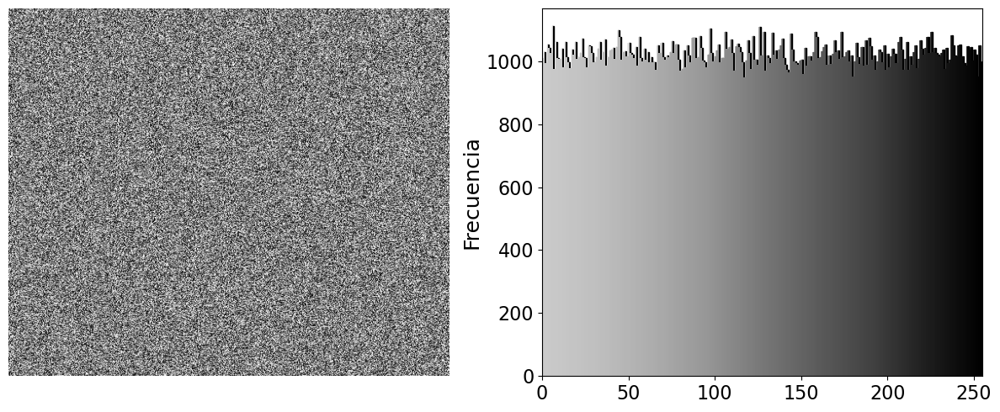

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
baboon_ciph = enigmarot_cipher(baboon_arr)
baboon_imgciph = Image.fromarray(baboon_ciph[0])
plot_image_and_histogram(baboon_imgciph)

In [3]:
np.sum([1010, 1028,  993, 1053, 1041, 1025, 1112,  975, 1061, 1009, 1008,
        1039,  980, 1062, 1014,  996,  977, 1037, 1020, 1062, 1007, 1014,
        1025, 1071, 1013, 1011,  982, 1051, 1047, 1025,  997, 1012, 1040,
        1062, 1005, 1028, 1068,  987, 1014, 1034, 1038, 1041, 1008, 1045,
        1097, 1077, 1004, 1028, 1031, 1015, 1057, 1026, 1020, 1010, 1045,
         987, 1076, 1009,  999, 1040, 1004, 1029,  997, 1012,  996,  997,
         974, 1051, 1026, 1059, 1013, 1005, 1017, 1014, 1029, 1063, 1025,
        1053, 1054, 1005,  969,  975, 1033,  982, 1050, 1019,  997, 1073,
        1074, 1011, 1014, 1079, 1041, 1003,  997,  981, 1021, 1104, 1027,
         999, 1016, 1035, 1052,  996, 1011, 1011, 1092, 1039, 1046, 1069,
        1026,  971, 1047, 1056, 1045, 1030,  998,  949, 1003, 1067, 1026,
         975, 1079, 1006, 1005,  989, 1108, 1017, 1094,  971, 1019, 1011,
         994, 1091, 1020, 1033, 1008, 1038, 1049, 1071, 1010,  990,  973,
         966, 1087, 1038,  999,  995,  990, 1002, 1005,  960, 1043,  985,
        1016, 1016, 1001, 1030, 1094, 1077, 1010, 1014, 1031, 1044, 1052,
         990, 1017,  992, 1023, 1067, 1030, 1034, 1007, 1094, 1013, 1016,
        1029, 1033,  999, 1018,  952,  999, 1059, 1012,  991, 1045,  987,
        1067,  990, 1073, 1048, 1006, 1018,  973, 1000, 1037, 1030,  996,
        1050,  974, 1024,  981, 1016, 1040, 1023,  995, 1062, 1076, 1036,
         973, 1008, 1061,  972, 1015,  989, 1028, 1050,  977, 1008, 1067,
        1039, 1020, 1042, 1076, 1026, 1093, 1028, 1043, 1026, 1022, 1015,
        1025, 1037,  976, 1041,  993, 1005, 1082, 1051, 1018, 1016, 1051,
        1053, 1015,  994,  987, 1048, 1038, 1044, 1003, 1037, 1022,  950,
        1049,  998, 1000])

262144

[177, 27, 250, 29, 48, 128, 158, 140, 131, 84, 242, 252, 81, 39, 69, 25, 168, 3, 214, 146, 248, 179, 1, 104, 96, 61, 37, 109, 164, 163, 210, 138, 0, 35, 178, 88, 103, 254, 52, 224, 110, 23, 235, 127, 15, 176, 67, 102, 225, 192, 56, 213, 216, 238, 217, 194, 218, 199, 87, 184, 212, 209, 108, 115, 232, 70, 107, 137, 54, 83, 201, 117, 31, 169, 236, 153, 223, 66, 147, 19, 231, 145, 78, 32, 124, 174, 62, 191, 161, 22, 190, 95, 98, 100, 157, 8, 152, 75, 60, 149, 246, 85, 154, 77, 175, 187, 139, 36, 245, 114, 6, 211, 21, 57, 136, 226, 185, 198, 113, 38, 55, 41, 129, 249, 227, 125, 20, 151, 122, 123, 24, 132, 234, 112, 64, 120, 50, 72, 51, 253, 219, 188, 167, 233, 111, 221, 59, 86, 189, 11, 12, 133, 195, 33, 4, 47, 173, 182, 92, 205, 165, 93, 9, 130, 58, 181, 134, 28, 17, 71, 63, 162, 171, 141, 44, 40, 160, 34, 26, 206, 10, 244, 80, 14, 45, 159, 247, 135, 183, 166, 46, 106, 101, 65, 243, 220, 251, 237, 49, 208, 197, 97, 193, 43, 255, 156, 148, 89, 239, 203, 222, 91, 73, 7, 229, 186, 82, 202, 10

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_46871/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


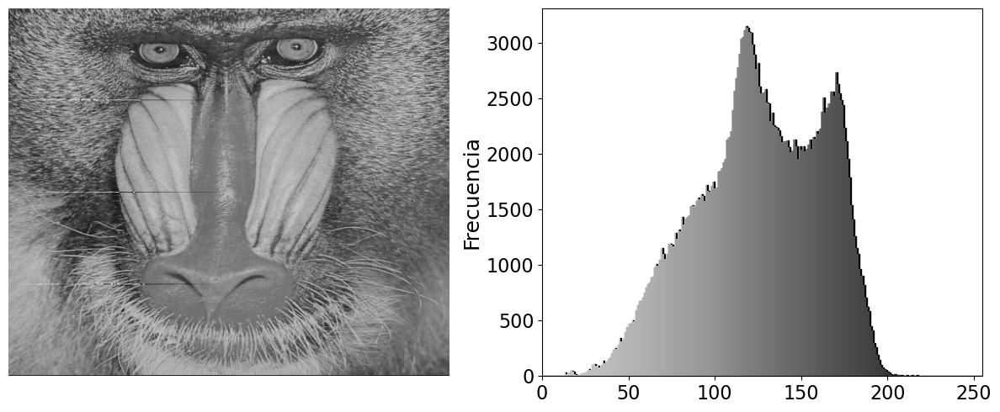

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
baboon_deciph = enigmarot_decipher(baboon_ciph[0],baboon_ciph[1])
# baboon_imgciph = Image.fromarray(baboon_ciph[0])
plot_image_and_histogram(baboon_deciph[0])

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_1221/221475919.py:95: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


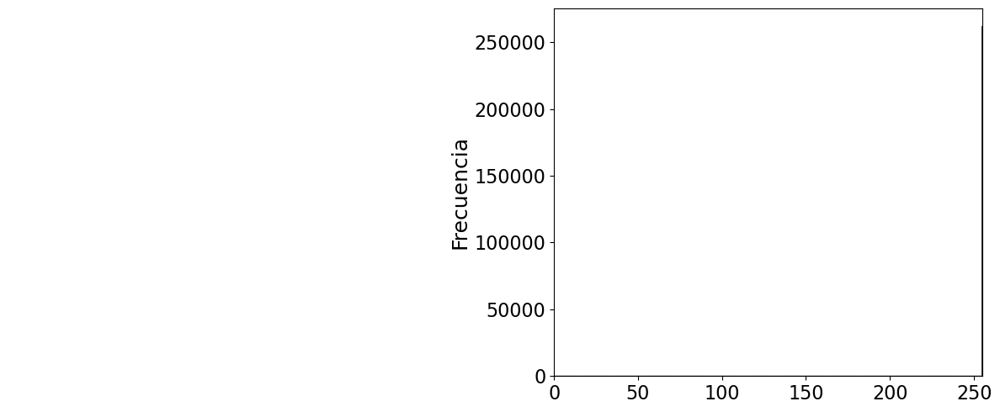

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [25]:
white_arr = np.full((512,512),255,dtype=np.int8)
white_img = Image.fromarray(white_arr)
plot_image_and_histogram(white_img)

[37, 47, 35, 137, 67, 40, 81, 54, 110, 53, 2, 213, 248, 237, 104, 153, 159, 133, 91, 1, 71, 218, 20, 3, 11, 123, 181, 152, 227, 196, 44, 190, 60, 144, 45, 184, 72, 82, 149, 59, 9, 31, 160, 173, 100, 128, 198, 6, 215, 240, 219, 252, 220, 172, 212, 10, 203, 229, 250, 79, 39, 18, 23, 84, 217, 65, 192, 119, 150, 246, 221, 55, 13, 19, 183, 85, 105, 52, 185, 223, 231, 46, 106, 155, 36, 226, 64, 15, 38, 249, 232, 236, 210, 176, 140, 197, 200, 241, 75, 204, 146, 207, 143, 167, 73, 174, 48, 121, 251, 180, 24, 202, 87, 125, 216, 28, 90, 182, 21, 154, 222, 238, 5, 99, 235, 142, 228, 92, 56, 171, 98, 68, 193, 243, 58, 139, 233, 102, 157, 0, 22, 208, 62, 76, 88, 118, 138, 74, 103, 205, 239, 117, 145, 147, 114, 33, 151, 109, 224, 101, 178, 166, 134, 170, 175, 30, 27, 93, 12, 66, 162, 41, 245, 195, 255, 148, 187, 129, 135, 43, 214, 78, 4, 156, 168, 26, 77, 89, 69, 130, 254, 127, 83, 186, 244, 25, 201, 225, 163, 126, 161, 8, 247, 96, 211, 158, 80, 63, 188, 189, 51, 177, 234, 113, 179, 242, 116, 7, 131

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_1221/221475919.py:95: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


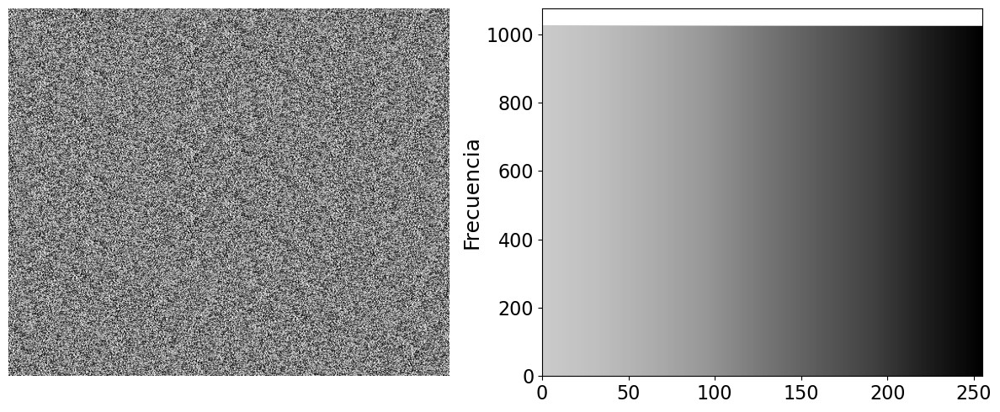

In [26]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
white_ciph = enigmarot_cipher(white_arr,xinits)
whiteciphered = Image.fromarray(white_ciph[0])
bins, hist = plot_image_and_histogram(whiteciphered)

In [29]:
print(np.sum(hist),np.size(white_arr))

262144 262144


/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_34528/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


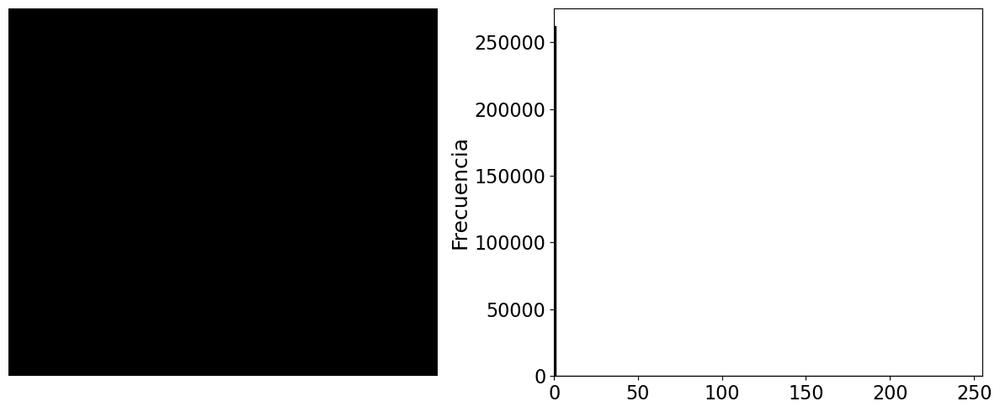

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
black_arr = np.zeros((512,512),dtype=np.int8)
black_img = Image.fromarray(black_arr)
plot_image_and_histogram(black_img)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_62029/2117733309.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


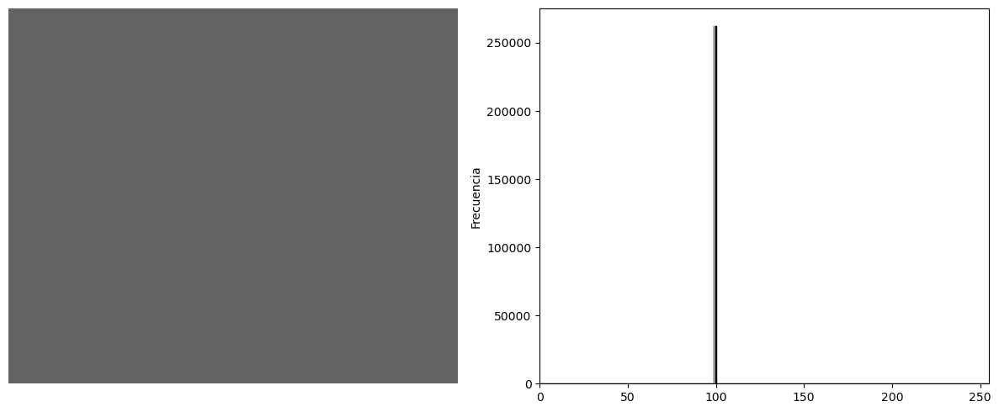

(<Figure size 1200x500 with 2 Axes>,
 array([<Axes: >, <Axes: ylabel='Frecuencia'>], dtype=object))

In [ ]:
black_enc = sbox_aes.encode_image(black_img)
black_encimg = Image.fromarray(black_enc)
plot_image_and_histogram(black_encimg)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_34528/4127467583.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


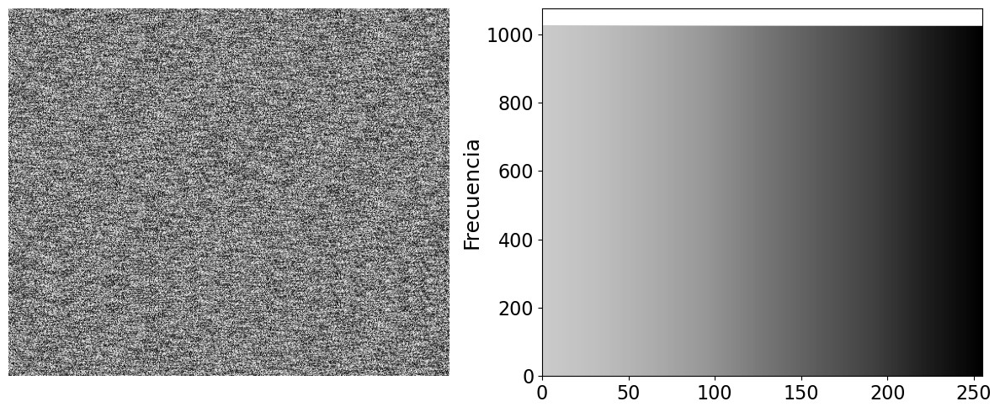

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [ ]:
black = enigmarot_cipher(black_arr)
ciphered = Image.fromarray(black[0])
plot_image_and_histogram(ciphered)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_4100/2013189887.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


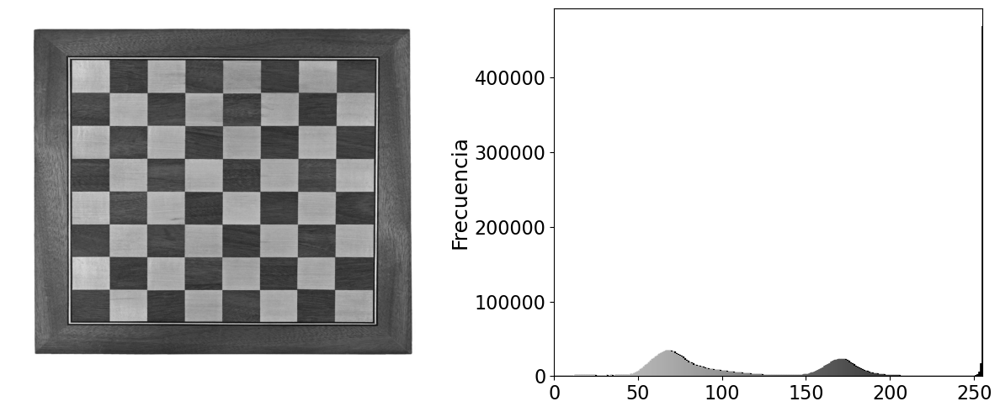

(array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
         11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
         22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
         33.,  34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,
         44.,  45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,
         55.,  56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,
         66.,  67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,
         77.,  78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,
         88.,  89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,
         99., 100., 101., 102., 103., 104., 105., 106., 107., 108., 109.,
        110., 111., 112., 113., 114., 115., 116., 117., 118., 119., 120.,
        121., 122., 123., 124., 125., 126., 127., 128., 129., 130., 131.,
        132., 133., 134., 135., 136., 137., 138., 139., 140., 141., 142.,
        143., 144., 145., 146., 147., 

In [146]:
plot_image_and_histogram(chess_img)

/var/folders/_v/s5gldkfj5yqfzxf08sjyc8vc0000gn/T/ipykernel_62029/2117733309.py:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('Greys')


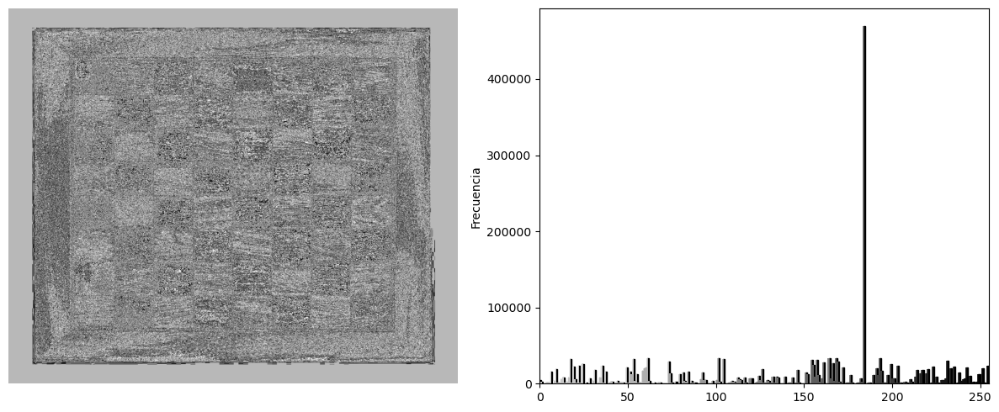

(<Figure size 1200x500 with 2 Axes>,
 array([<Axes: >, <Axes: ylabel='Frecuencia'>], dtype=object))

In [ ]:
chess_enc = sbox_pwlm.encode_image(chess_img)
chess_encoded = Image.fromarray(chess_enc)
plot_image_and_histogram(chess_encoded)

In [1]:
xinits = [[np.random.uniform(-255,255),np.random.uniform(-137.7,137.7)] for i in range(3)]
chess_ciph = enigmarot_cipher(chess_img,xinits)
chess_ciphered = Image.fromarray(chess_ciph[0])
plot_image_and_histogram(chess_ciphered)

NameError: name 'np' is not defined

In [ ]:
np.round(psnr(lena_arr,resltt[0]),4)

array([7912.145 ,    9.1479])

In [ ]:
calculate_pixel_correlation(ciphered)

{'Horizontal': 0.10599,
 'Vertical': 0.28719,
 'Diagonal': 0.08973,
 'Avg': 0.16097}

In [ ]:
calculate_image_entropy(ciphered)

7.930698166818008

In [ ]:
img1 = np.array(lena_img)
img1_shape = np.shape(img1)
img2 = np.array(lena_img)
xex1,xex2 = random.randint(0,img1_shape[0]),random.randint(0,img1_shape[1])
img2[xex1,xex2]=0 if img2[xex1,xex2]!=0 else 1
ciph_img1 = enigmarot_cipher(img1)
ciph_img2 = enigmarot_cipher(img2)
C = (img1 != img2).astype(int)
D = (ciph_img1[0] == ciph_img2[0]).astype(int)
print(np.where(D==True),np.where(C==True))

(array([], dtype=int64), array([], dtype=int64)) (array([27]), array([231]))


In [ ]:
def npcr_analysis(image):
    img1 = np.array(image)
    img1_shape = np.shape(img1)
    img2 = np.array(image)
    xex1,xex2 = random.randint(0,img1_shape[0]),random.randint(0,img1_shape[1])
    img2[xex1,xex2]=0 if img2[xex1,xex2]!=0 else 1
    ciph_img1 = enigmarot_cipher(img1)[0]
    ciph_img2 = enigmarot_cipher(img2)[0]
    C = (img1==img2)
    print(img1[xex1,xex2],img2[xex1,xex2])
    print(xex1,xex2)
    print(np.where(~C))
    D = (ciph_img1 == ciph_img2)
    print(np.where(~D))
    # 2. Calcular suma de diferencias
    sum_diff = np.sum(np.size(D))
    
    # 3. Calcular NPCR
    total_pixels = img1.size
    npcr_value = (sum_diff / total_pixels) * 100.0
    
    return npcr_value

    # print(img1[xex1,xex2],img2[xex1,xex2])
    # print(xex1,xex2)
    # print((img1==img1).all())
    # print((img1==img2).all())

print(npcr_analysis(lena_img))
# print(np.where(~npcr_analysis(lena_img)[1]))

118 0
16 329
(array([16]), array([329]))
(array([  0,   0,   0, ..., 511, 511, 511]), array([  0,   1,   2, ..., 509, 510, 511]))
100.0


In [ ]:
print(resltt[1][0].table)
print(resltt[1][1].table)
print(resltt[1][2].table)
print(resltt[2])
print(resltt[3][0],resltt[3][3])
for i in range(3):
    resltt[1][i].reset_table()

print(resltt[1][0].table)
print(resltt[1][1].table)
print(resltt[1][2].table)

[31, 215, 160, 137, 229, 114, 219, 70, 86, 246, 233, 104, 166, 122, 30, 101, 123, 235, 239, 65, 67, 102, 220, 41, 193, 100, 99, 186, 253, 16, 208, 17, 11, 52, 223, 23, 159, 32, 221, 138, 194, 181, 15, 61, 128, 192, 199, 209, 189, 145, 149, 204, 43, 212, 213, 224, 54, 57, 1, 247, 132, 195, 92, 59, 185, 125, 93, 248, 110, 184, 21, 55, 127, 157, 111, 151, 156, 120, 117, 133, 88, 136, 134, 63, 115, 231, 25, 201, 170, 96, 103, 254, 197, 0, 18, 83, 95, 53, 124, 89, 147, 158, 50, 228, 121, 66, 8, 29, 143, 22, 3, 214, 44, 183, 24, 206, 252, 205, 129, 33, 152, 190, 168, 230, 12, 112, 180, 5, 19, 178, 46, 146, 4, 85, 251, 234, 250, 171, 155, 27, 90, 7, 2, 82, 237, 14, 165, 240, 38, 79, 40, 108, 130, 98, 249, 36, 175, 78, 222, 69, 144, 163, 216, 73, 244, 150, 60, 236, 245, 119, 241, 64, 218, 139, 148, 72, 109, 200, 203, 42, 105, 75, 97, 87, 187, 164, 202, 118, 6, 210, 116, 51, 172, 135, 217, 227, 153, 10, 142, 39, 176, 58, 9, 47, 179, 37, 106, 211, 191, 28, 182, 84, 207, 71, 91, 198, 45, 94, 162,